Making necessary imports

In [136]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

import math
from keras.models import Sequential
from keras.layers import Dense, SimpleRNN, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

# from scipy import stats

Defining the list of companies to predict the stock price for. (Temporarily narrowed down to one stock for testing of the model)

In [186]:
tickers = ['aapl'                                                                                       # stock from Fin. statements dataset
, 'msft', 'aig', 'pcg', 'mcd', 'bcs', 'nvda', 'intc', 'amzn',                                           # stocks from Fin. statements dataset
            'duk', 'so', 'exc', 't', 'vz', 'ctl', 'o', 'spg', 'nly', 'pg',                              # dividend stocks
           'ko', 'pep', 'xom', 'cvx', 'cop', 'wfc', 'bac', 'jpm', 'pfe', 'jnj', 'yum',                  # dividend stocks continued
          'shld', 'jcp', 'chk', 'bb', 'ftr', 'c',                                                       # declining stocks
         'spy','vti', 'iwm', 'ijr', 'ijh', 'tlt','gld','slv',]                                          # main etfs

Reading csv files with stock price data, converting date to datetime, cleaning from unneeded columns.

In [140]:
stock_dfs = {}
for t in tickers:
    # read csv files
    stock_dfs[t]=pd.read_csv(f'../data/clean_csv/{t}.csv')
    # convert date to datetime
    stock_dfs[t]["Date"] = pd.to_datetime(stock_dfs[t]["Date"])
    # Drop irrelevant columns
    stock_dfs[t].drop(columns=['Unnamed: 0', 'OpenInt', 'Open', 'High', 'Low'],inplace=True)
    # Set 'Date' as index
    stock_dfs[t].set_index('Date', inplace=True)
    # Resample to quarterly data and keep the last price in each quarter
    stock_dfs[t] = stock_dfs[t].resample('QE').last()

    # Reset index to make 'Date' a column again
    stock_dfs[t].reset_index(inplace=True)

    print(f'{t}')
    print(stock_dfs[t].shape)

aapl
(134, 4)
msft
(128, 4)
aig
(134, 4)
pcg
(152, 4)
mcd
(192, 4)
bcs
(52, 4)
nvda
(76, 4)
intc
(184, 4)
amzn
(83, 4)
duk
(139, 4)
so
(144, 4)
exc
(152, 4)
t
(134, 4)
vz
(137, 4)
ctl
(121, 4)
o
(52, 4)
spg
(97, 4)
nly
(52, 4)
pg
(192, 4)
ko
(192, 4)
pep
(164, 4)
xom
(192, 4)
cvx
(192, 4)
cop
(144, 4)
wfc
(133, 4)
bac
(127, 4)
jpm
(192, 4)
pfe
(144, 4)
jnj
(192, 4)
mcd
(192, 4)
yum
(82, 4)
shld
(52, 4)
jcp
(144, 4)
chk
(52, 4)
bb
(76, 4)
ftr
(52, 4)
c
(192, 4)
spy
(52, 4)
vti
(52, 4)
iwm
(52, 4)
ijr
(52, 4)
ijh
(52, 4)
tlt
(52, 4)
gld
(52, 4)
slv
(47, 4)


Splitting the data into train and test. Cannot do it without train_test_split function, as it does not maintain the sequence of data, because of it's randomization parameter. 

In [142]:
train_dfs = {}
test_dfs = {}

for t in tickers:
    
    # Train-test split manually
    len_data = len(stock_dfs[t])     #Count of rows that data has
    len_train = round(len_data * 0.75)   # %75 train + %25 test
    len_test = len_data - len_train
   
    print(f'Total rows: {len_data}; Train rows: {len_train}; Test rows: {len_test}.')

    train_dfs[t] = stock_dfs[t][:len_train]
    test_dfs[t] = stock_dfs[t][len_train:]
    # printing to show that train and test dfs do not intersect
    print(t)
    print(train_dfs[t].tail(5))
    print(test_dfs[t].head(5))

Total rows: 134; Train rows: 100; Test rows: 34.
aapl
         Date   Close     Volume  C_returns
95 2008-06-30  21.444  190779913  -0.015427
96 2008-09-30  14.553  453452613   0.079599
97 2008-12-31  10.931  169432011  -0.010769
98 2009-03-31  13.463  158814361   0.006278
99 2009-06-30  18.240  121020836   0.003356
          Date   Close     Volume  C_returns
100 2009-09-30  23.736  150370039  -0.000168
101 2009-12-31  26.988   98076551  -0.004243
102 2010-03-31  30.094  119860348  -0.003642
103 2010-06-30  32.212  205878957  -0.018106
104 2010-09-30  36.338  187626938  -0.012608
Total rows: 128; Train rows: 96; Test rows: 32.
msft
         Date   Close     Volume  C_returns
91 2008-12-31  16.302   55354243   0.005117
92 2009-03-31  15.405  109816468   0.050890
93 2009-06-30  19.933   79218122  -0.003798
94 2009-09-30  21.568   75750593  -0.001158
95 2009-12-31  25.561   38050423  -0.015484
          Date   Close    Volume  C_returns
96  2010-03-31  24.562  76030920  -0.016182
97  201

Reshaping the datasets for the model

In [143]:
train_datasets = {}
test_datasets = {}

# Creating datasets and shaping their form for the model.
for t in tickers:
    train_datasets[t] = train_dfs[t]['Close'].values
    train_datasets[t] = np.reshape(train_datasets[t], (-1, 1))

    test_datasets[t] = test_dfs[t]['Close'].values
    test_datasets[t] = np.reshape(test_datasets[t], (-1, 1))

Scaling train data. Applying lookback window. Reshaping for model.

In [144]:
train_datasets_scaled = {}
scales = {}

X_trains = {}
y_trains = {}

Lookback = 10

for t in tickers:
    # Scaling train Dataset
    scales[t] = MinMaxScaler(feature_range = (0,1))
    train_datasets_scaled[t] = scales[t].fit_transform(train_datasets[t])
    X_trains[t] = []
    y_trains[t] = []
    len_train = len(train_datasets_scaled[t])

    # Creating a moving window of size Lookback for the forecast
    for i in range(Lookback, len_train):
        X_trains[t].append(train_datasets_scaled[t][i - Lookback:i, 0])
        y_trains[t].append(train_datasets_scaled[t][i, 0])

    # Converting to Numpy array and reshaping for model
    X_trains[t], y_trains[t] = np.array(X_trains[t]), np.array(y_trains[t])
    X_trains[t] = np.reshape(X_trains[t], (X_trains[t].shape[0], X_trains[t].shape[1],1))
    y_trains[t] = np.reshape(y_trains[t], (y_trains[t].shape[0],1))
    print("Shape of X_trains:",X_trains[t].shape)
    print("Shape of y_trains:",y_trains[t].shape)
    

Shape of X_trains: (90, 10, 1)
Shape of y_trains: (90, 1)
Shape of X_trains: (86, 10, 1)
Shape of y_trains: (86, 1)
Shape of X_trains: (90, 10, 1)
Shape of y_trains: (90, 1)
Shape of X_trains: (104, 10, 1)
Shape of y_trains: (104, 1)
Shape of X_trains: (134, 10, 1)
Shape of y_trains: (134, 1)
Shape of X_trains: (29, 10, 1)
Shape of y_trains: (29, 1)
Shape of X_trains: (47, 10, 1)
Shape of y_trains: (47, 1)
Shape of X_trains: (128, 10, 1)
Shape of y_trains: (128, 1)
Shape of X_trains: (52, 10, 1)
Shape of y_trains: (52, 1)
Shape of X_trains: (94, 10, 1)
Shape of y_trains: (94, 1)
Shape of X_trains: (98, 10, 1)
Shape of y_trains: (98, 1)
Shape of X_trains: (104, 10, 1)
Shape of y_trains: (104, 1)
Shape of X_trains: (90, 10, 1)
Shape of y_trains: (90, 1)
Shape of X_trains: (93, 10, 1)
Shape of y_trains: (93, 1)
Shape of X_trains: (81, 10, 1)
Shape of y_trains: (81, 1)
Shape of X_trains: (29, 10, 1)
Shape of y_trains: (29, 1)
Shape of X_trains: (63, 10, 1)
Shape of y_trains: (63, 1)
Shape 

In [145]:
test_datasets_scaled = {}
test_scales = {}

X_tests = {}
y_tests = {}

for t in tickers:
    # Scaling test Dataset
    test_scales[t] = MinMaxScaler(feature_range = (0,1))
    test_datasets_scaled[t] = test_scales[t].fit_transform(test_datasets[t])
    X_tests[t] = []
    y_tests[t] = []
    len_test = len(test_datasets_scaled[t])

    # Creating a moving window of size Lookback for the forecast
    for i in range(Lookback, len_test):
        X_tests[t].append(test_datasets_scaled[t][i - Lookback:i, 0])
        y_tests[t].append(test_datasets_scaled[t][i, 0])

    # Converting to Numpy array and reshaping for model
    X_tests[t], y_tests[t] = np.array(X_tests[t]), np.array(y_tests[t])
    X_tests[t] = np.reshape(X_tests[t], (X_tests[t].shape[0], X_tests[t].shape[1],1))
    y_tests[t] = np.reshape(y_tests[t], (y_tests[t].shape[0],1))
    print({t})
    print("Shape of X_tests:",X_tests[t].shape)
    print("Shape of y_tests:",y_tests[t].shape)

{'aapl'}
Shape of X_tests: (24, 10, 1)
Shape of y_tests: (24, 1)
{'msft'}
Shape of X_tests: (22, 10, 1)
Shape of y_tests: (22, 1)
{'aig'}
Shape of X_tests: (24, 10, 1)
Shape of y_tests: (24, 1)
{'pcg'}
Shape of X_tests: (28, 10, 1)
Shape of y_tests: (28, 1)
{'mcd'}
Shape of X_tests: (38, 10, 1)
Shape of y_tests: (38, 1)
{'bcs'}
Shape of X_tests: (3, 10, 1)
Shape of y_tests: (3, 1)
{'nvda'}
Shape of X_tests: (9, 10, 1)
Shape of y_tests: (9, 1)
{'intc'}
Shape of X_tests: (36, 10, 1)
Shape of y_tests: (36, 1)
{'amzn'}
Shape of X_tests: (11, 10, 1)
Shape of y_tests: (11, 1)
{'duk'}
Shape of X_tests: (25, 10, 1)
Shape of y_tests: (25, 1)
{'so'}
Shape of X_tests: (26, 10, 1)
Shape of y_tests: (26, 1)
{'exc'}
Shape of X_tests: (28, 10, 1)
Shape of y_tests: (28, 1)
{'t'}
Shape of X_tests: (24, 10, 1)
Shape of y_tests: (24, 1)
{'vz'}
Shape of X_tests: (24, 10, 1)
Shape of y_tests: (24, 1)
{'ctl'}
Shape of X_tests: (20, 10, 1)
Shape of y_tests: (20, 1)
{'o'}
Shape of X_tests: (3, 10, 1)
Shape of

Building the model itself.

In [207]:
models = {}
histories = {}

for t in tickers:
    # initiate RNN
    models[t] = Sequential()
    
    # adding first RNN layer and dropout regulatization
    models[t].add(
        SimpleRNN(units = Lookback, 
                  activation = "tanh", 
                  return_sequences = True, 
                  input_shape = (X_trains[t].shape[1],1))
                 )
    
    models[t].add(
        Dropout(0.2)
                 )
    
    
    # adding second and third RNN layer and dropout regulatization
    
    models[t].add(
        SimpleRNN(units = Lookback, 
                  activation = "tanh", 
                  return_sequences = True)
                 )
    
    models[t].add(
        Dropout(0.2)
                 )

    models[t].add(
        SimpleRNN(units = Lookback, 
                  activation = "tanh", 
                  return_sequences = True)
                 )
    
    models[t].add(
        Dropout(0.2)
                 )
    
    # adding forth RNN layer and dropout regulatization
    
    models[t].add(
        SimpleRNN(units = Lookback)
                 )
    
    models[t].add(
        Dropout(0.2)
                 )
    
    # adding the output layer
    models[t].add(Dense(units = 1))
    
    # compiling RNN
    models[t].compile(
        optimizer = "adam", 
        loss = "mean_squared_error",
        metrics = ["accuracy"])
    
    # fitting the RNN
    histories[t] = models[t].fit(X_trains[t], y_trains[t], epochs = 50, batch_size = 32, verbose=0)

C:\Users\Vladimir\anaconda3\envs\ml_env\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


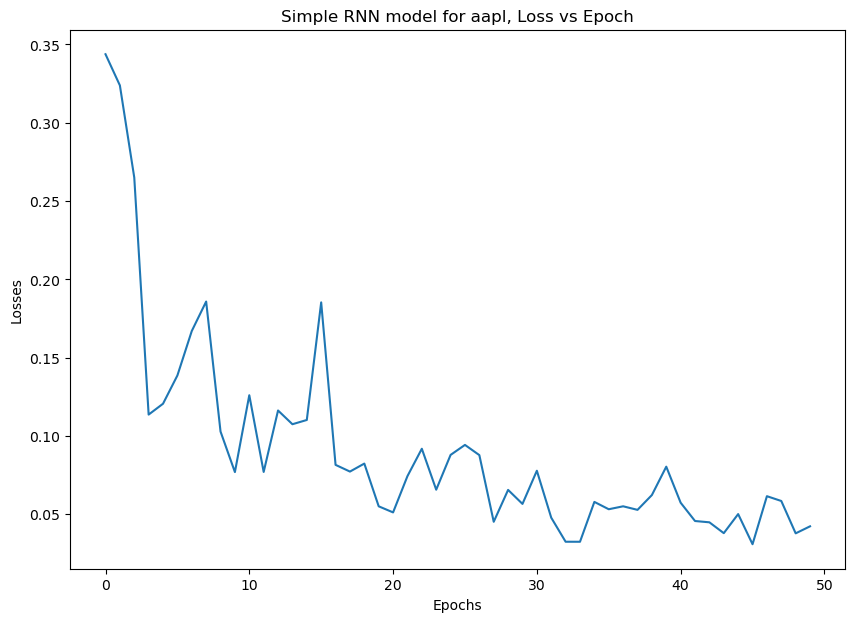

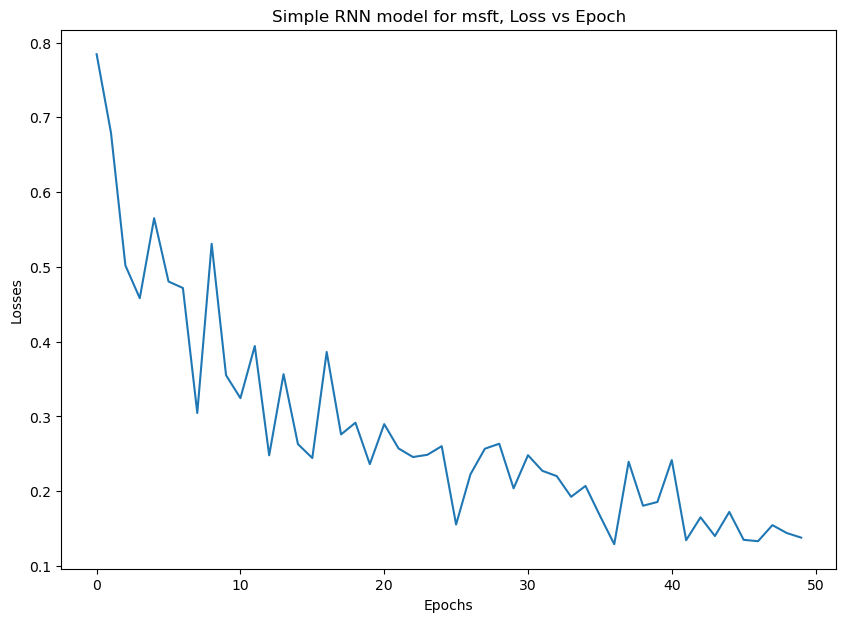

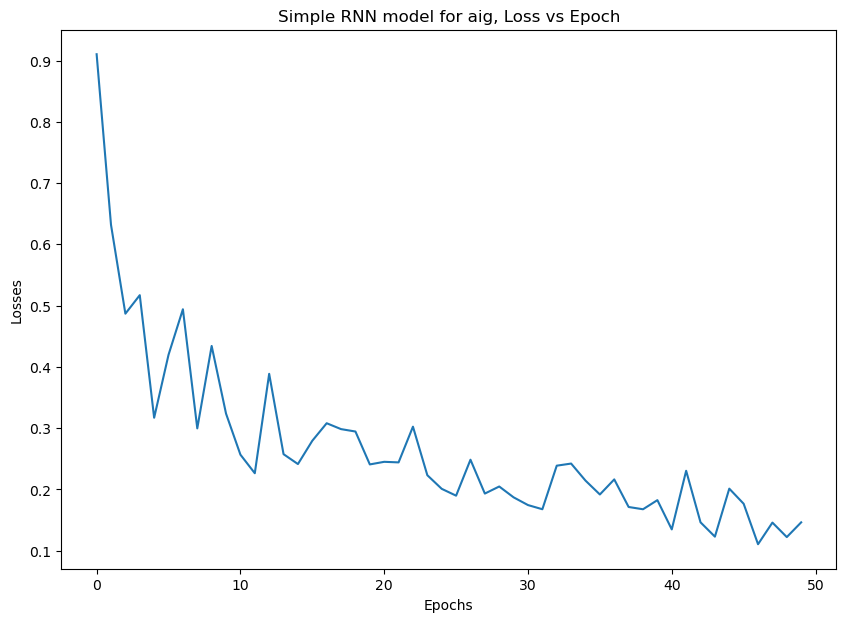

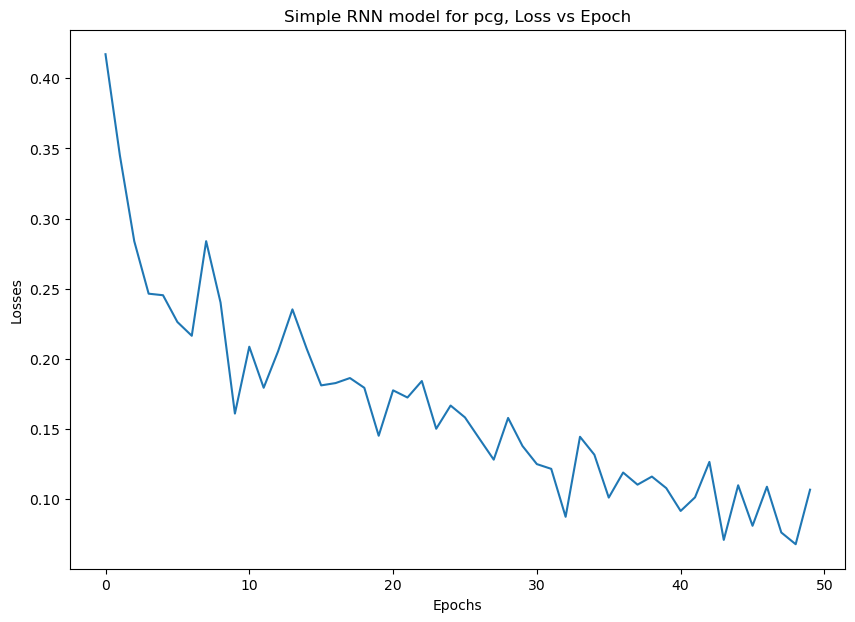

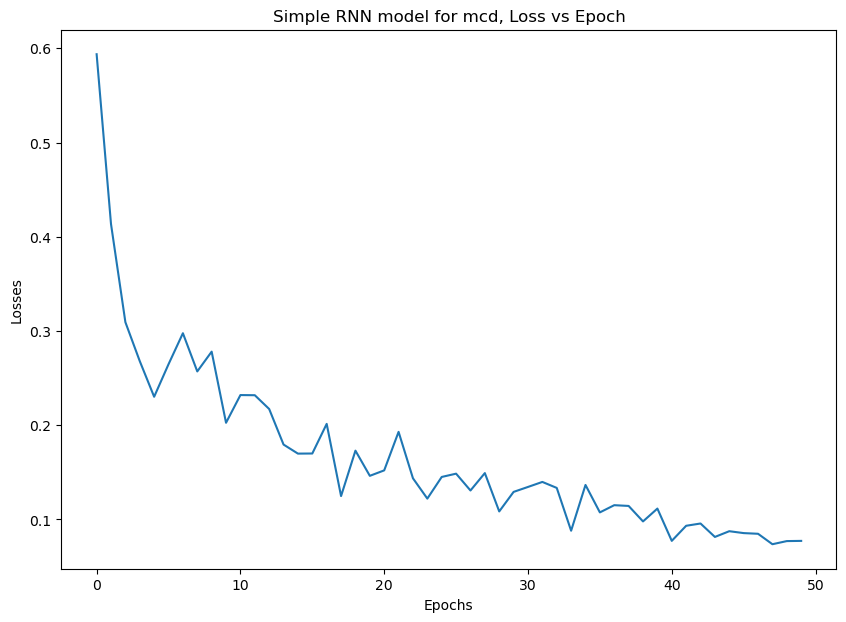

...

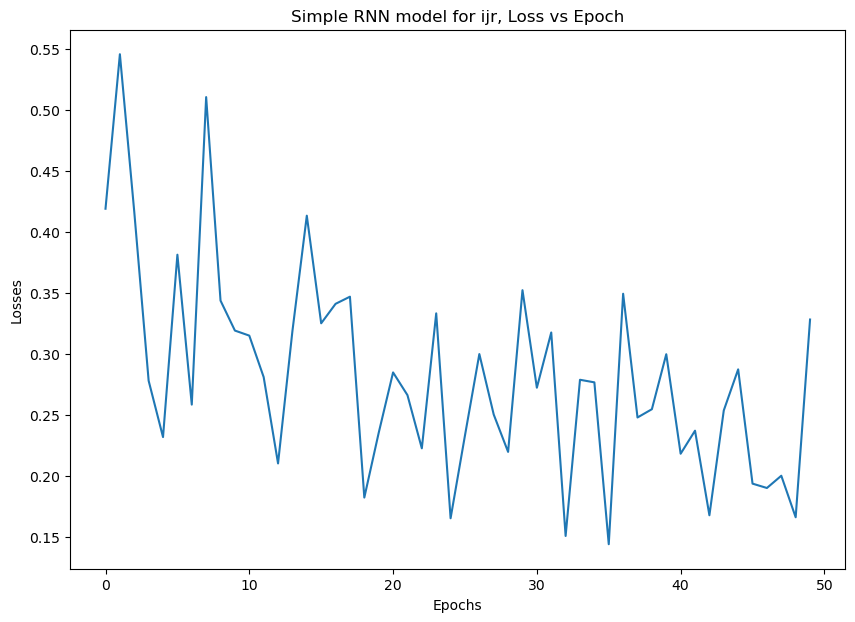

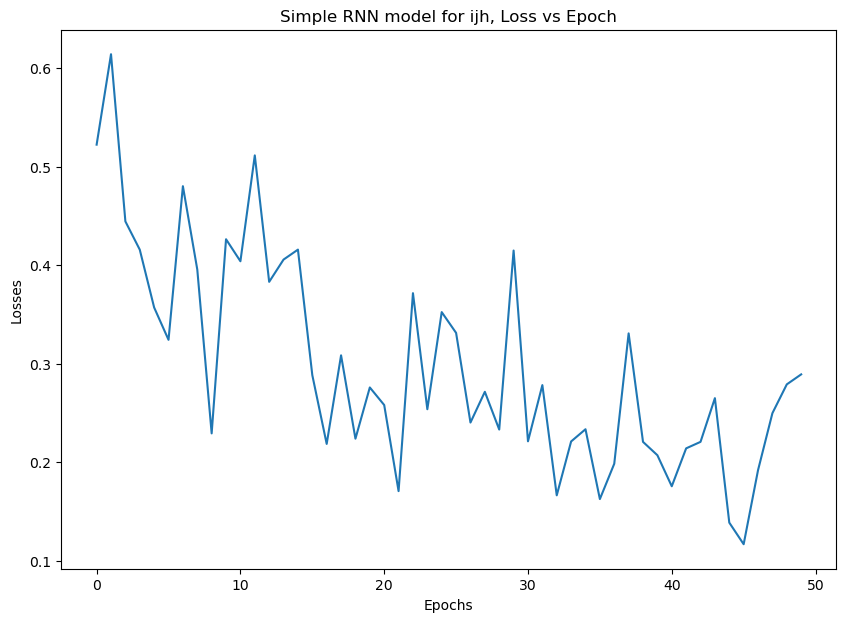

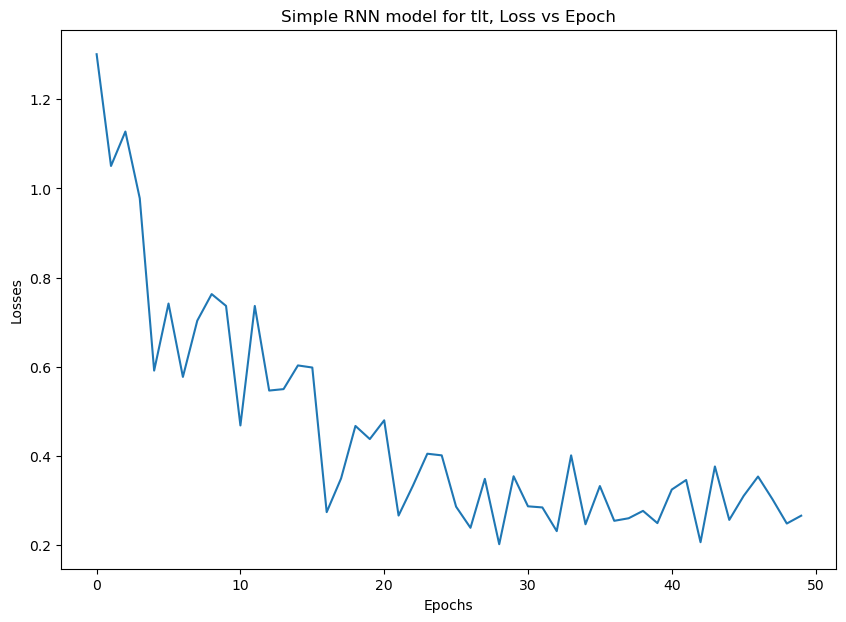

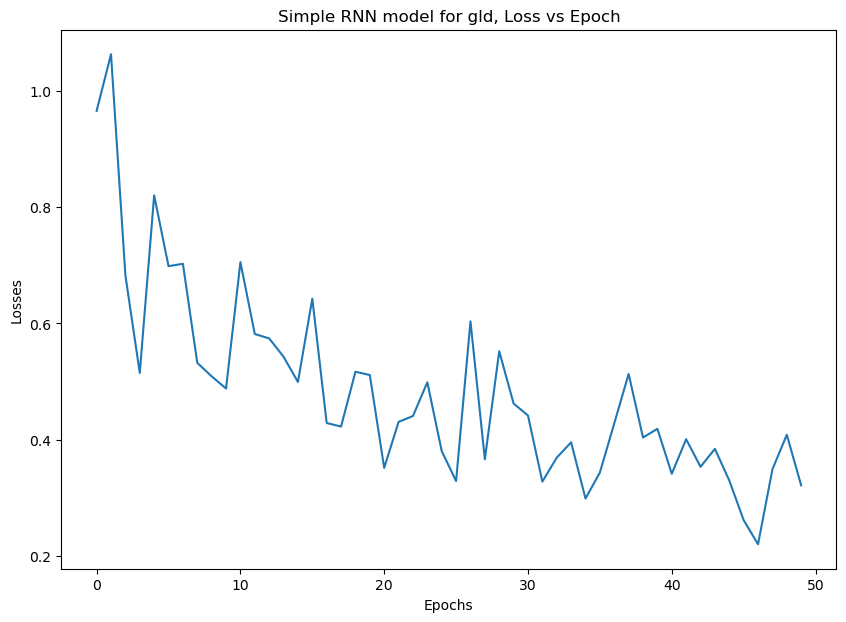

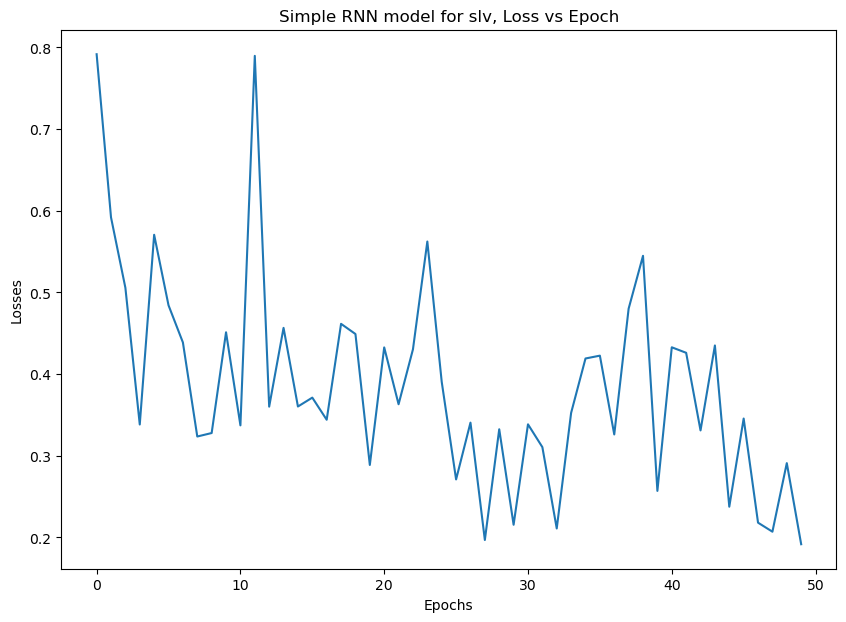

In [147]:
for t in tickers:
    # Plotting Loss vs Epochs
    plt.figure(figsize =(10,7))
    plt.plot(histories[t].history["loss"])
    plt.xlabel("Epochs")
    plt.ylabel("Losses")
    plt.title(f"Simple RNN model for {t}, Loss vs Epoch")
    plt.show()

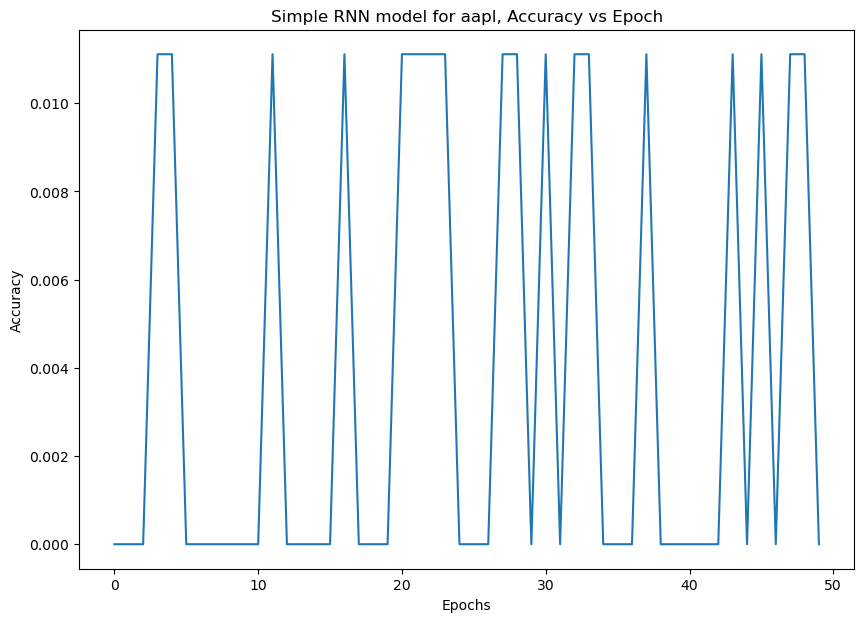

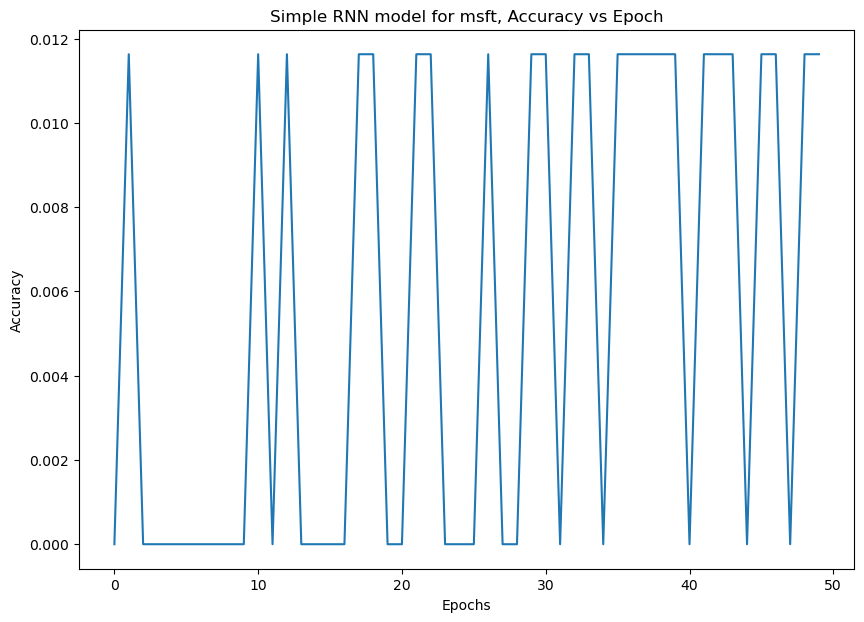

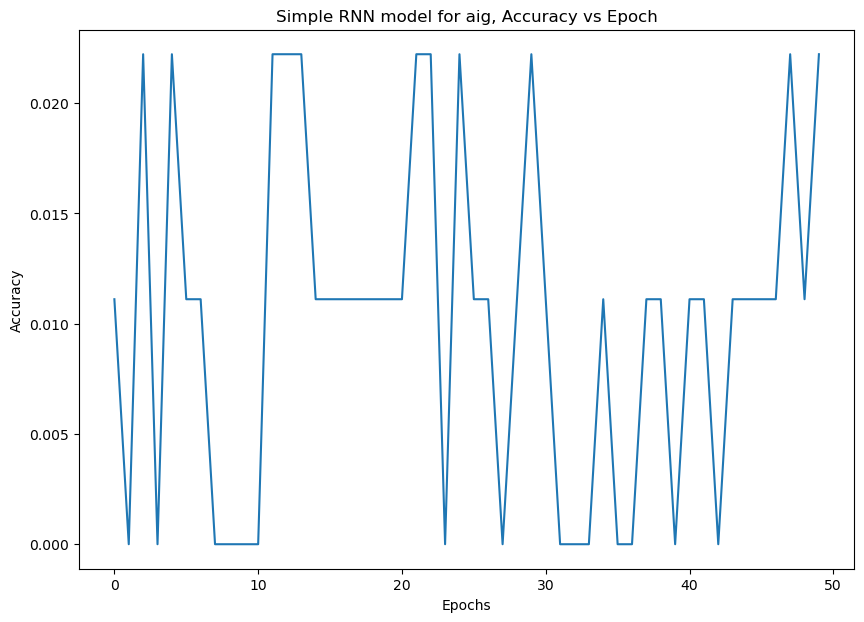

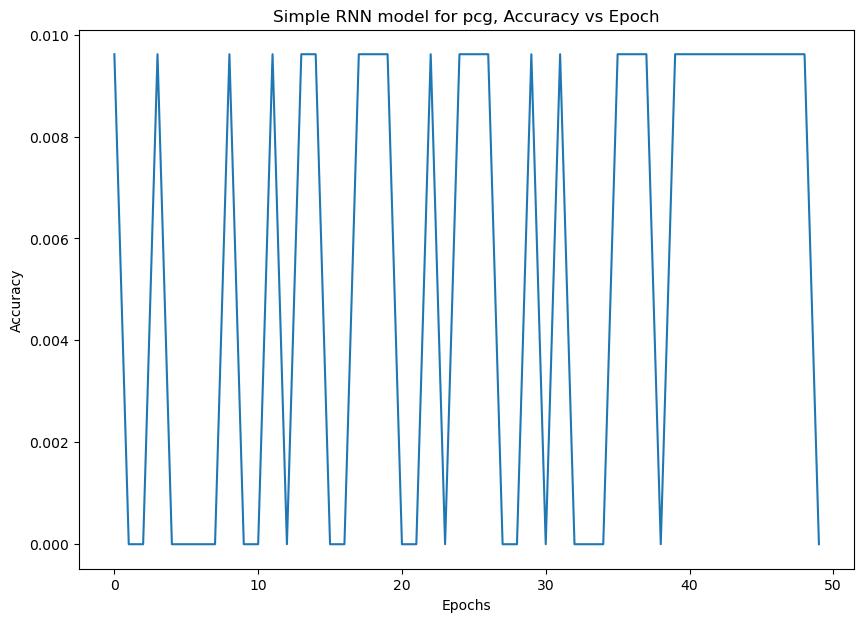

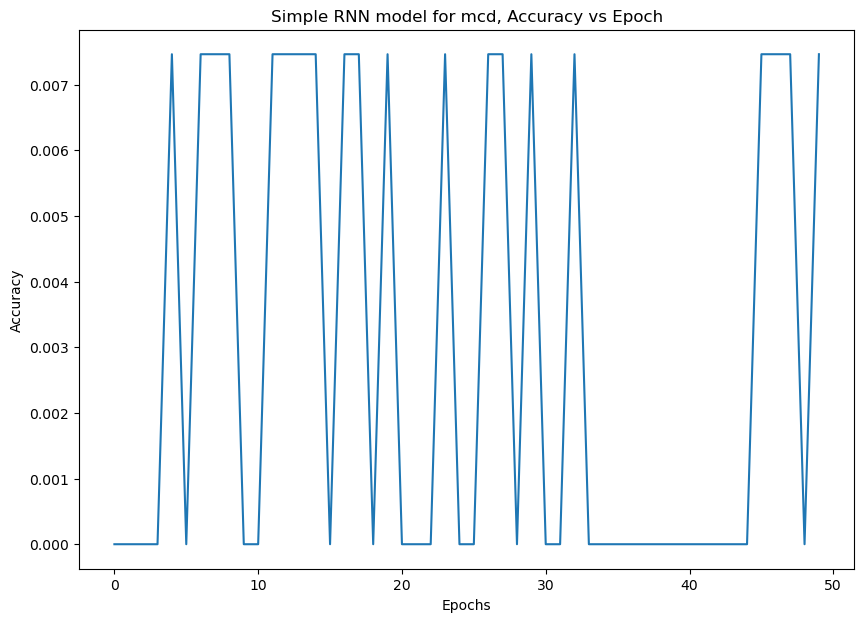

...

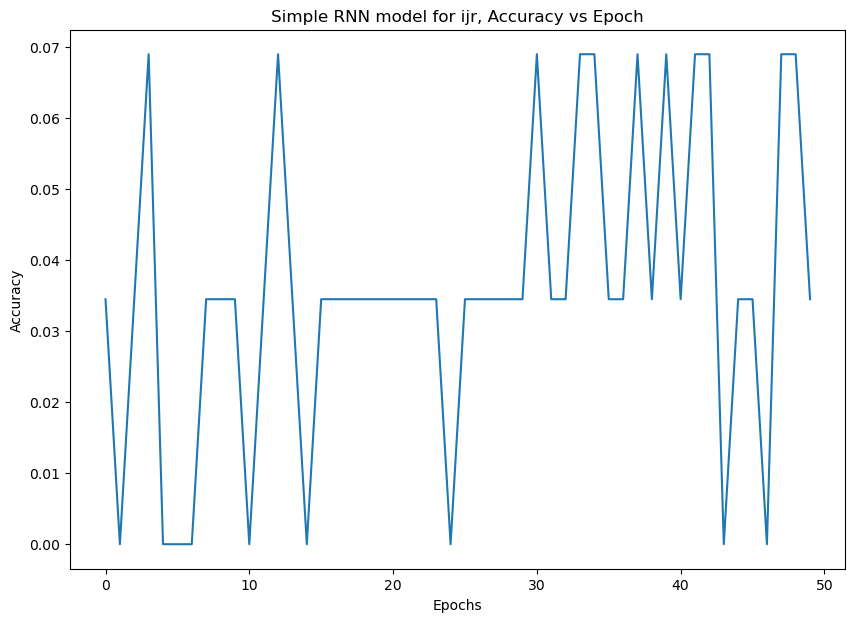

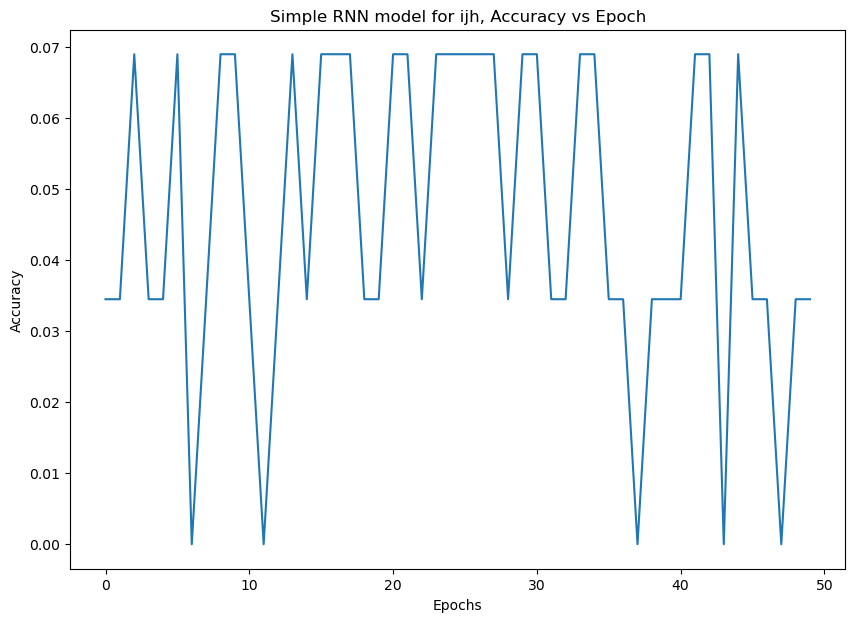

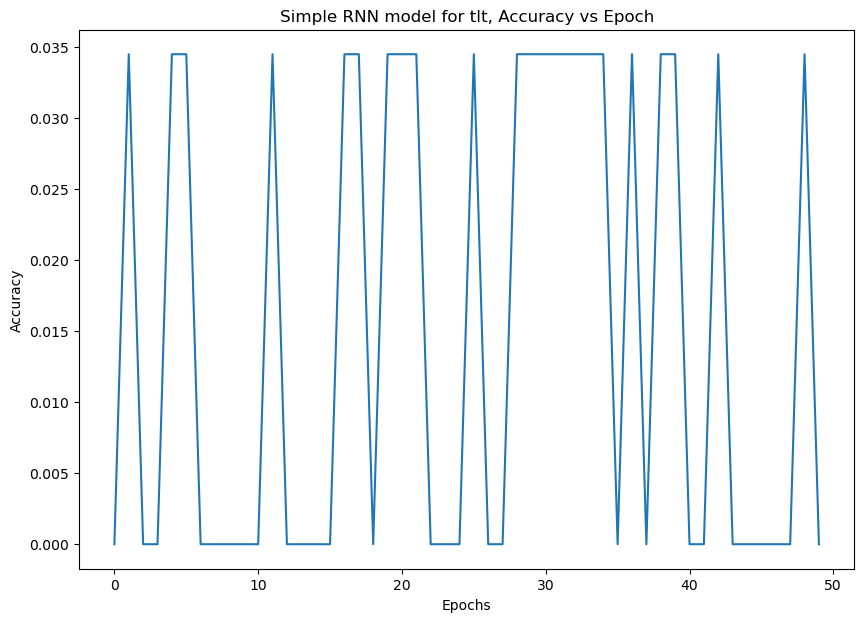

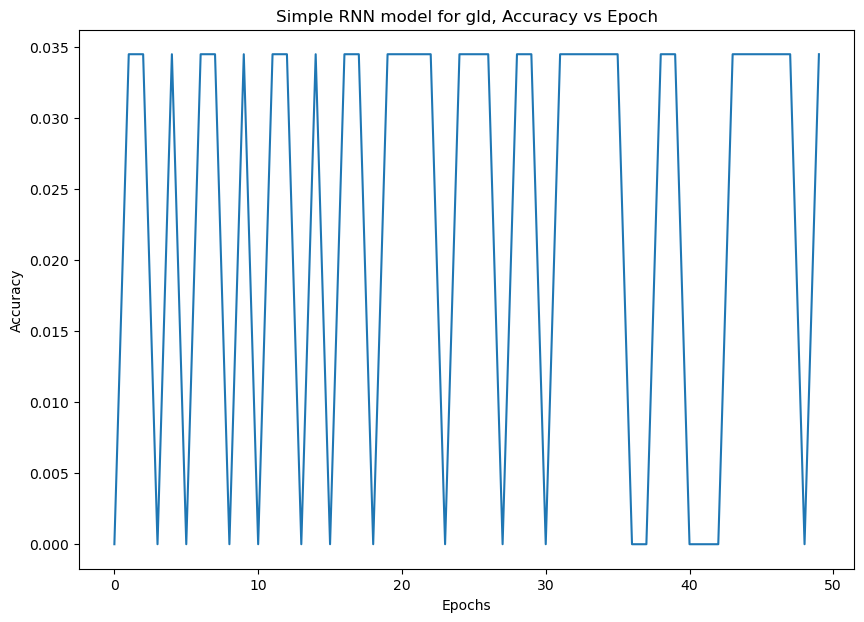

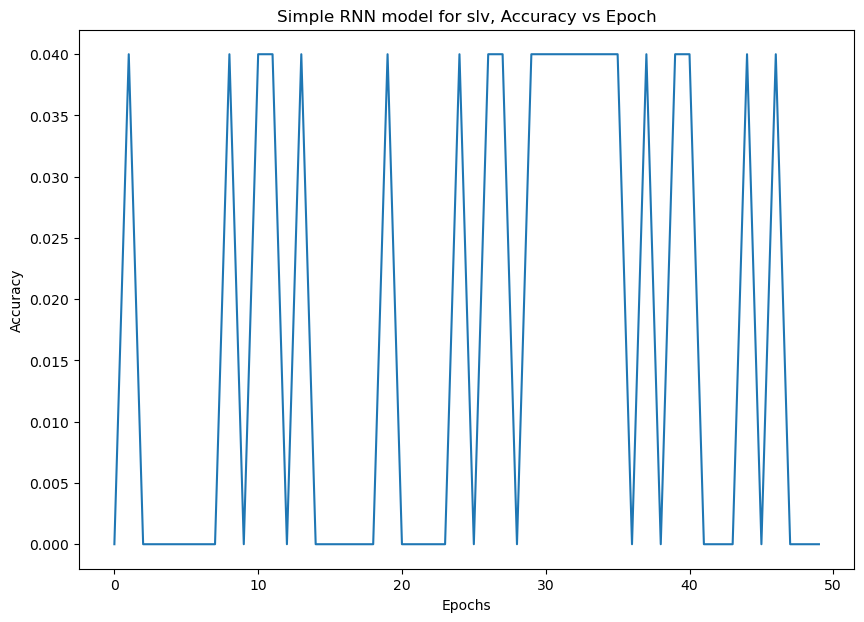

In [148]:
for t in tickers:
    # Plotting Accuracy vs Epochs
    plt.figure(figsize =(10,7))
    plt.plot(histories[t].history["accuracy"])
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.title(f"Simple RNN model for {t}, Accuracy vs Epoch")
    plt.show()

Making train predictions. Visualizing train data and prediction.


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 


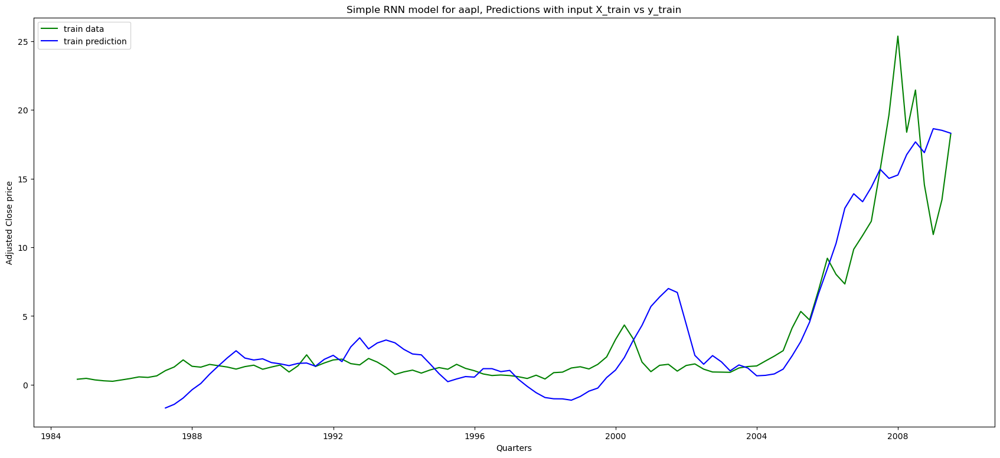

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


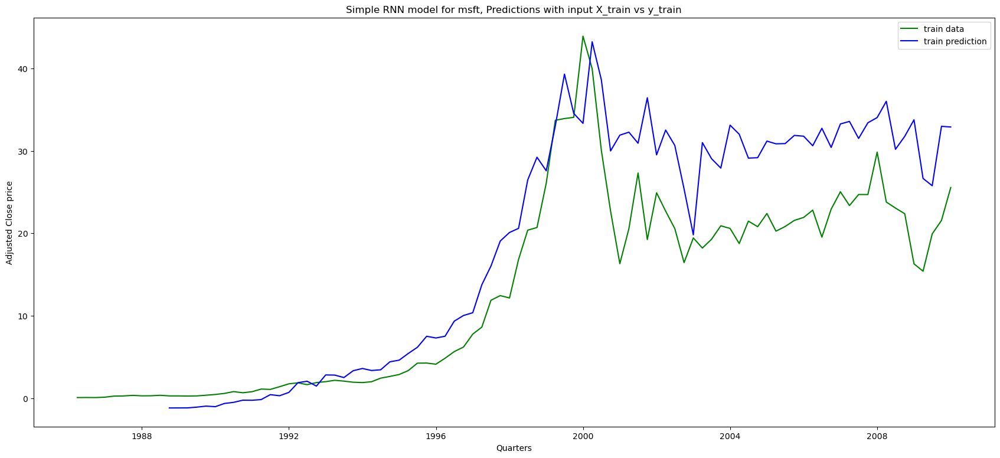

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


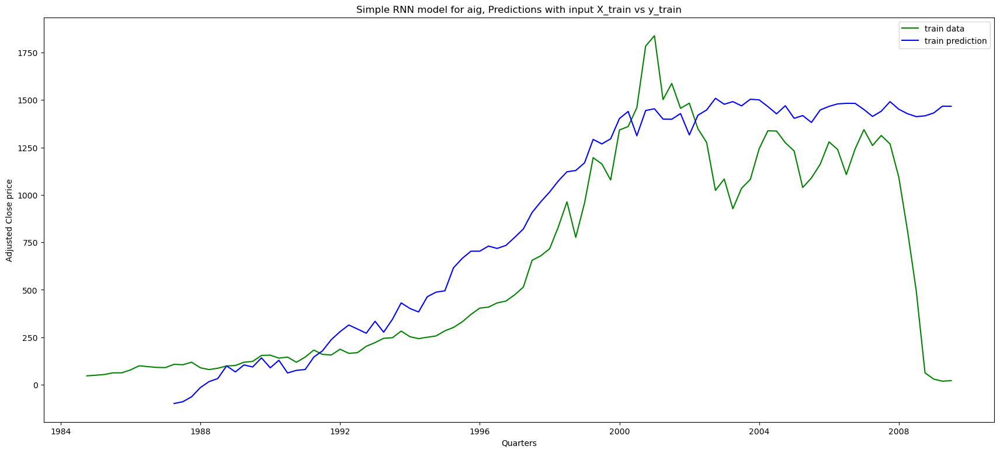

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


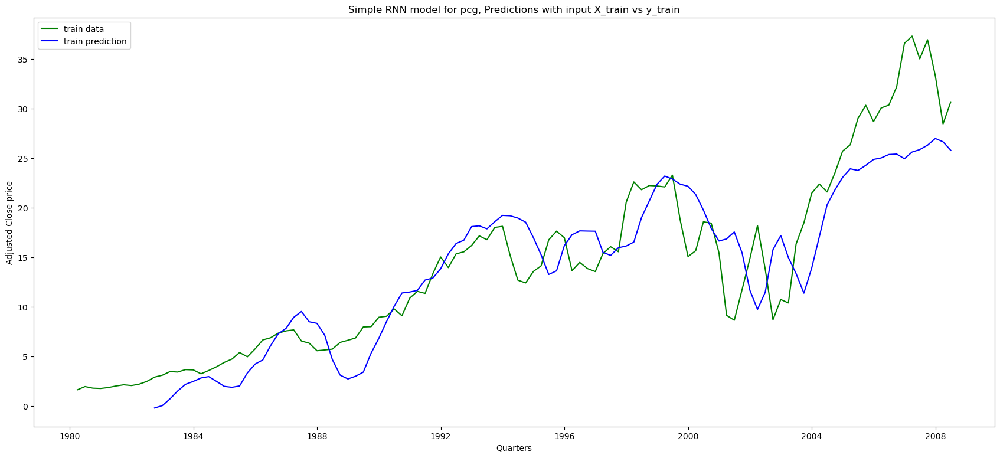

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


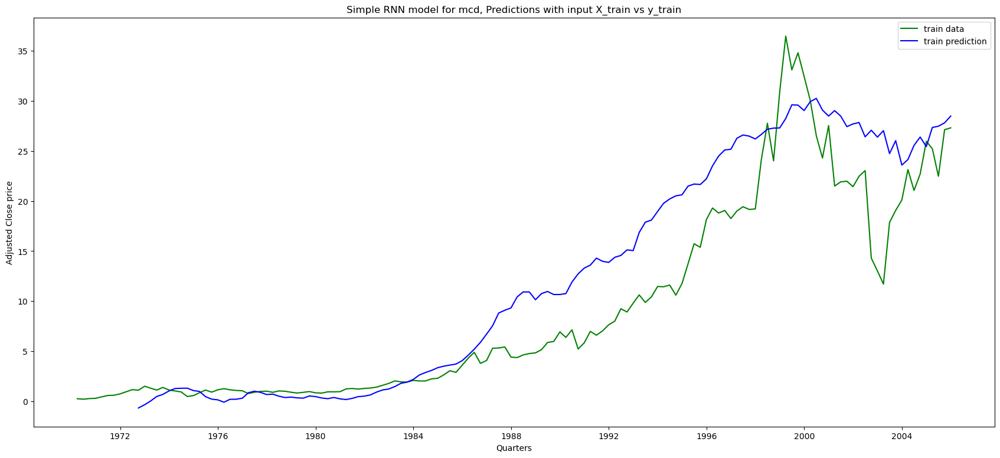

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


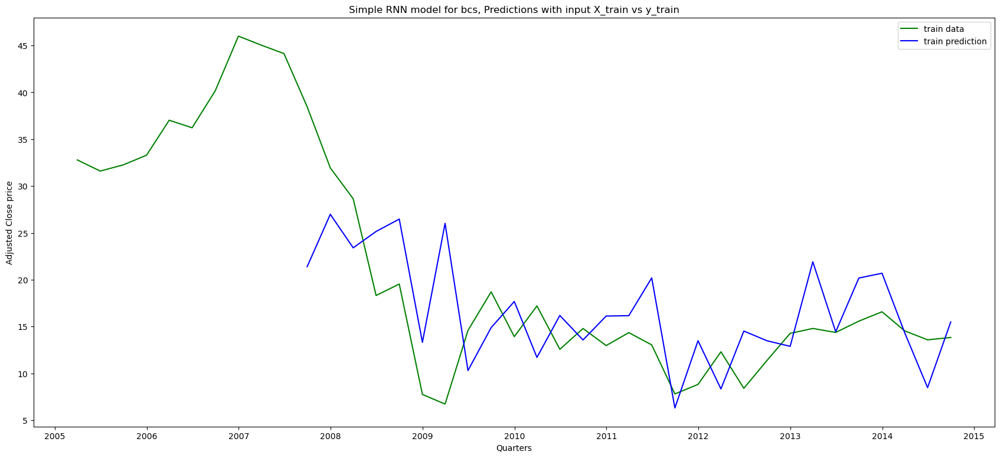

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 


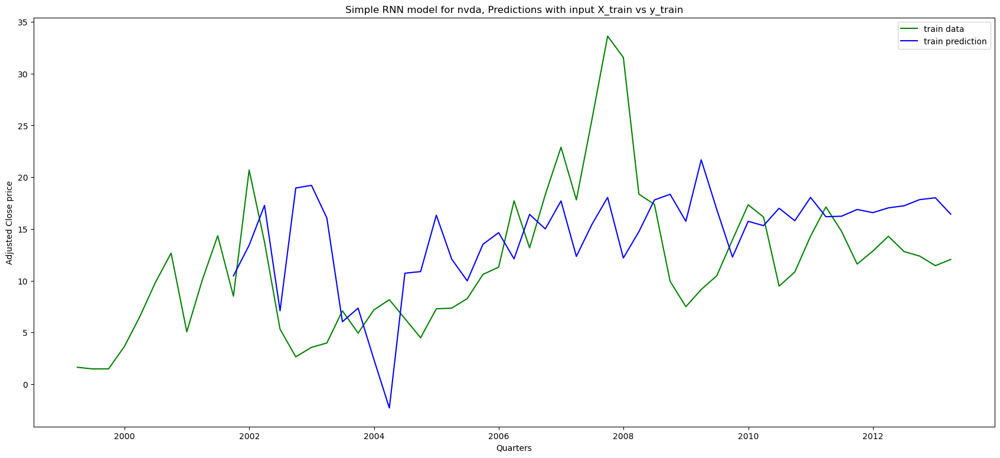

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


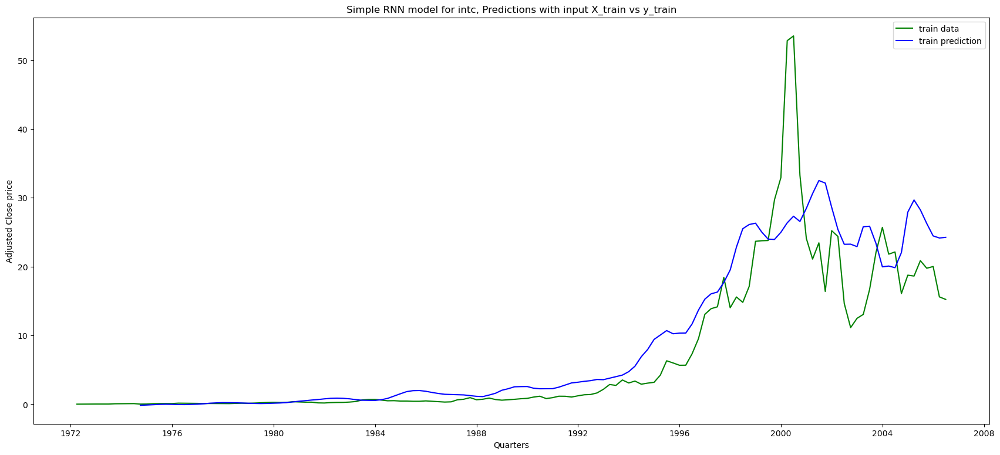

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


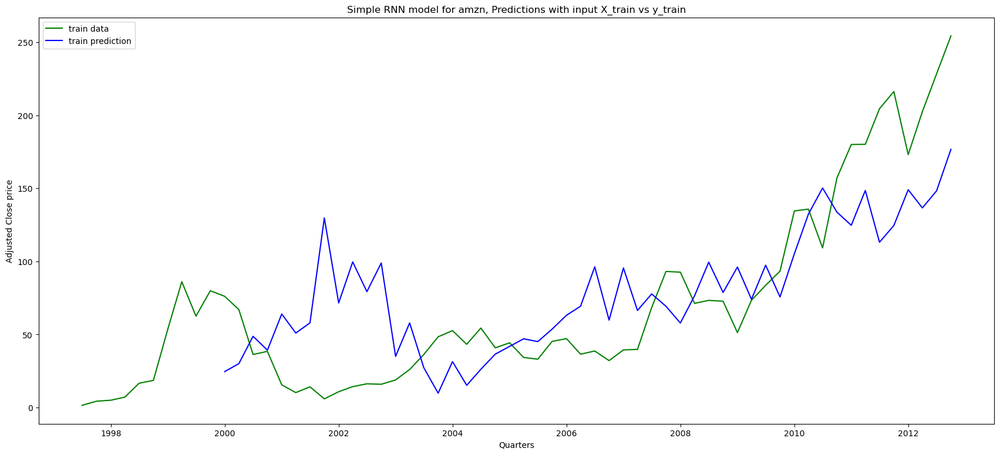

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


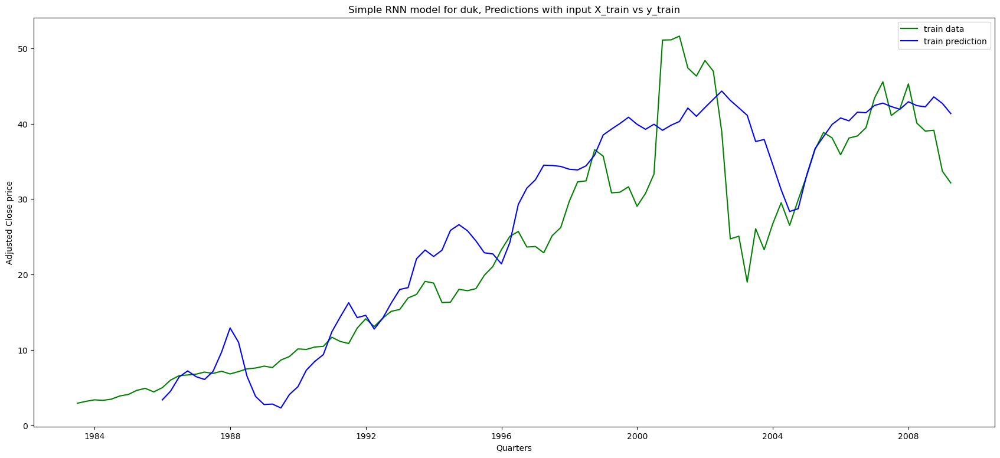

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


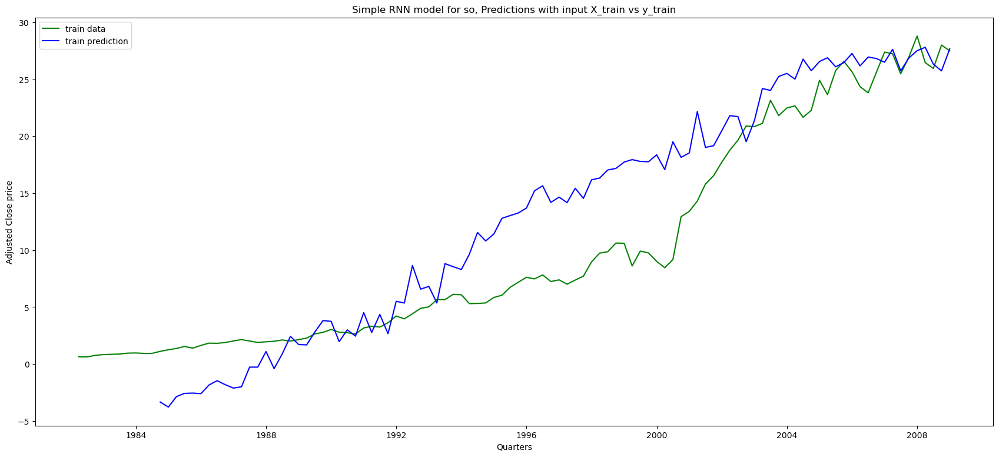

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


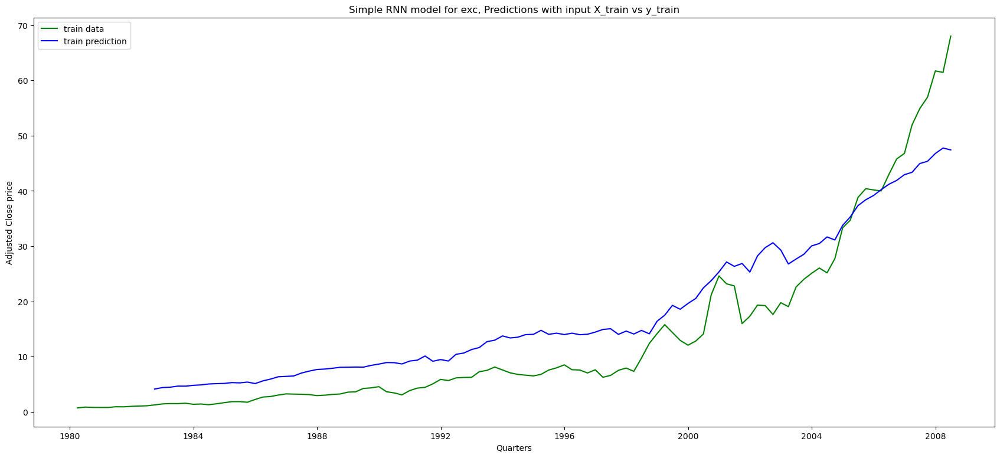

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


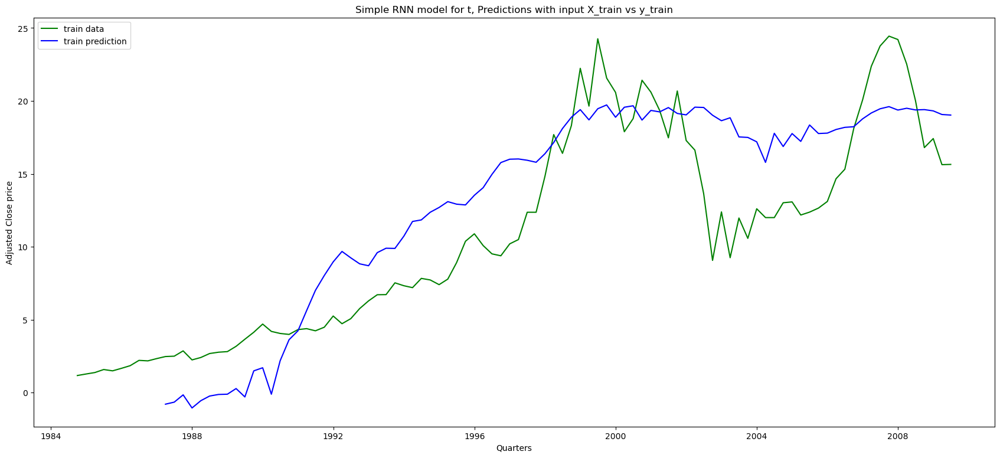

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


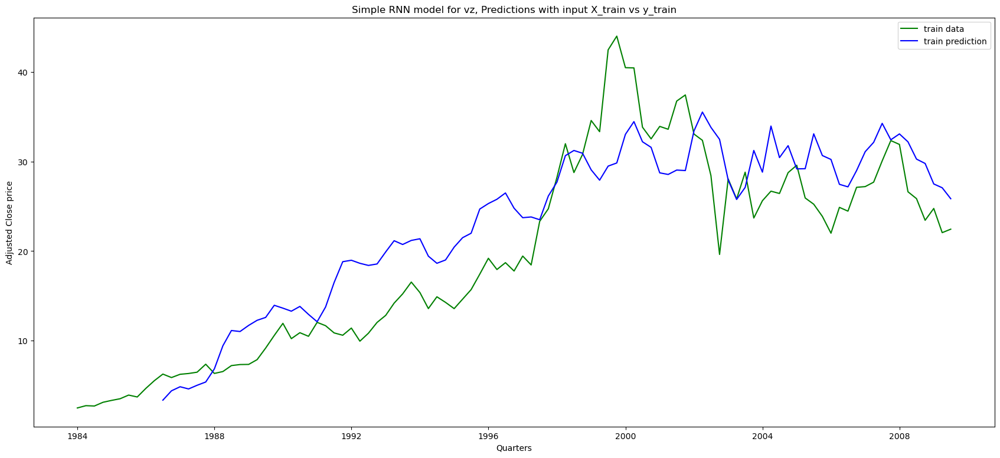

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


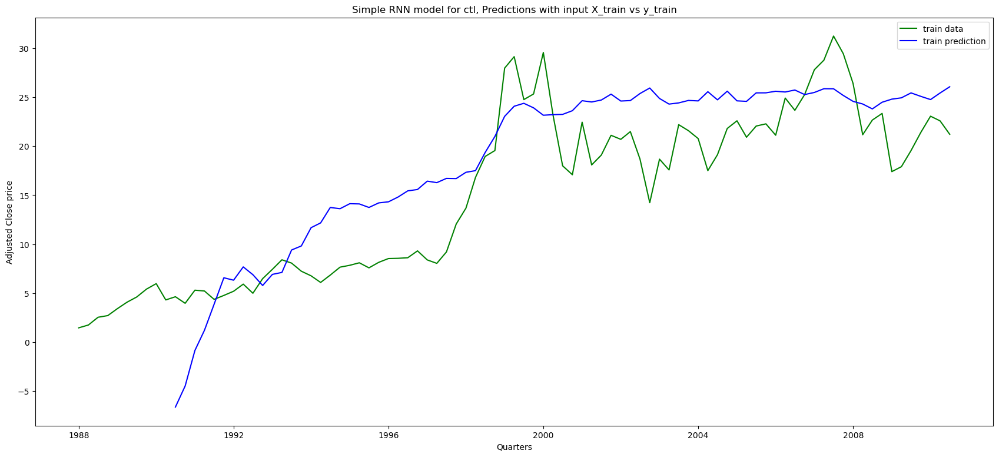

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


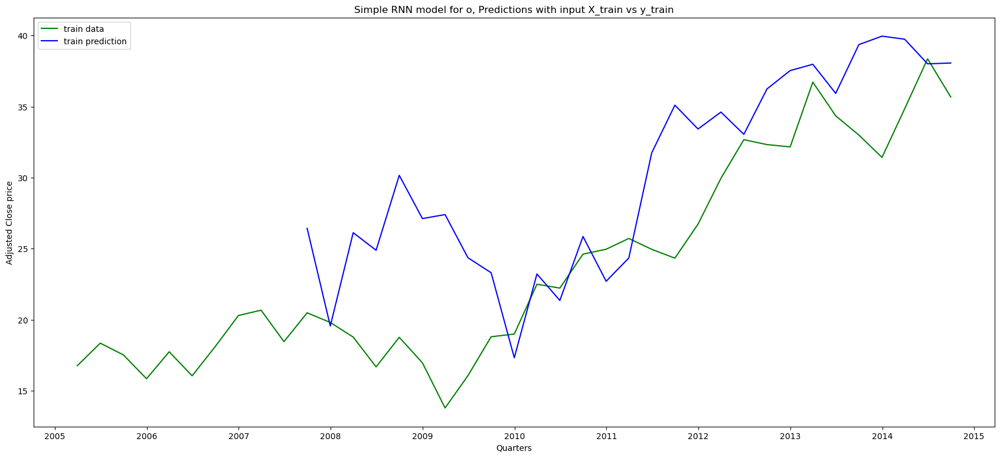

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 


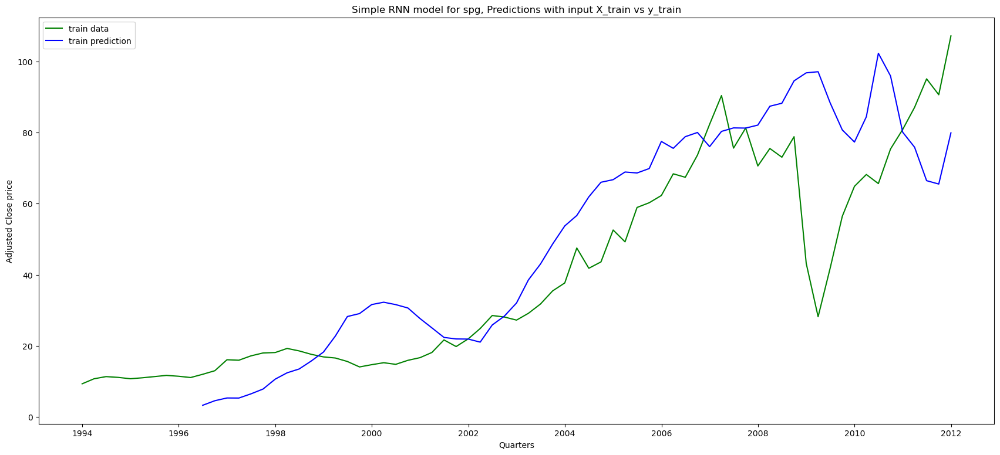

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


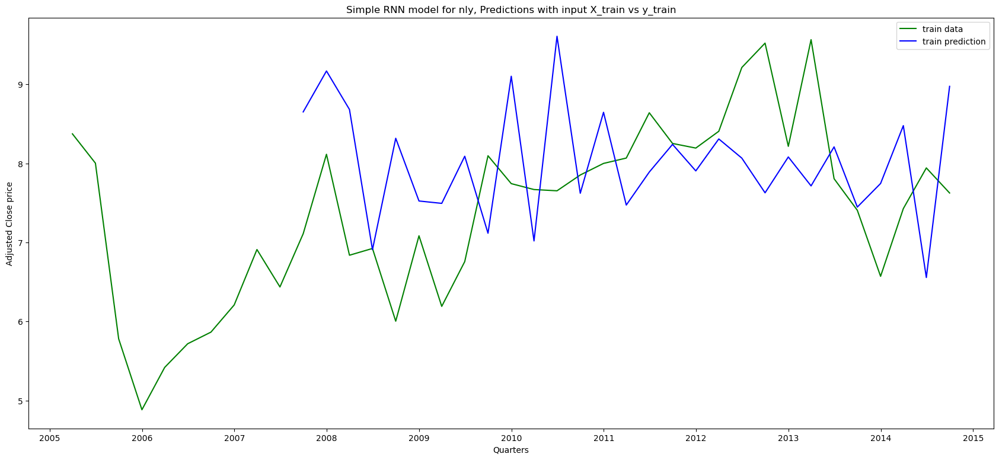

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


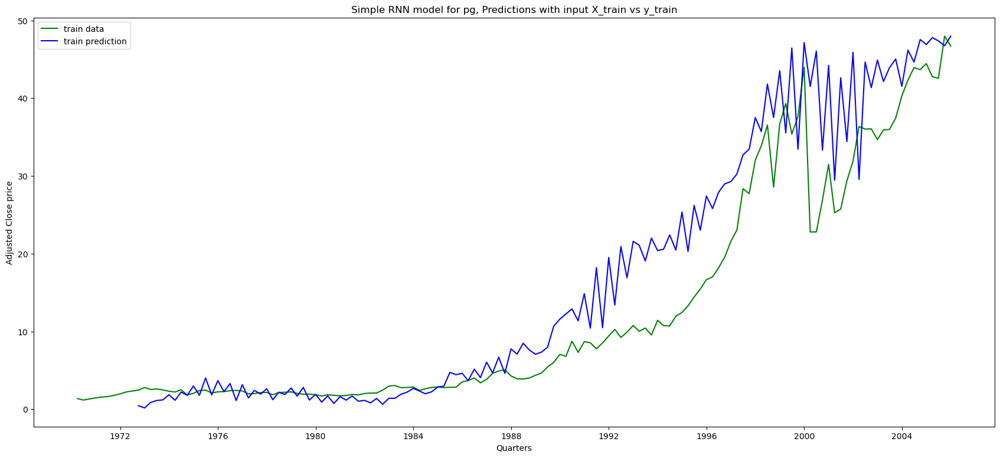

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


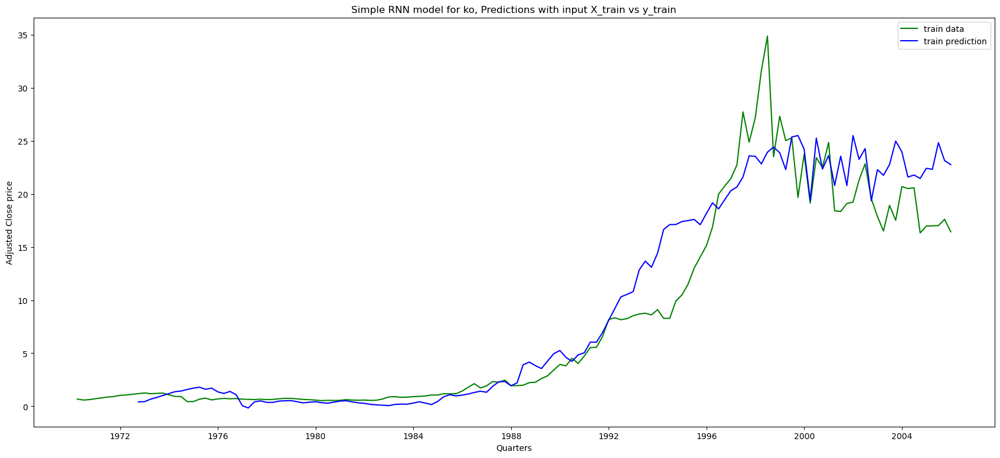

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


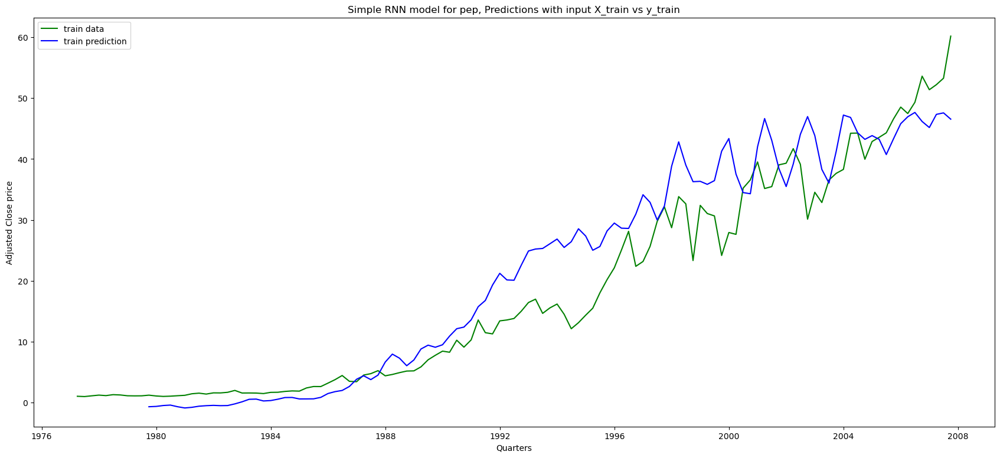

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


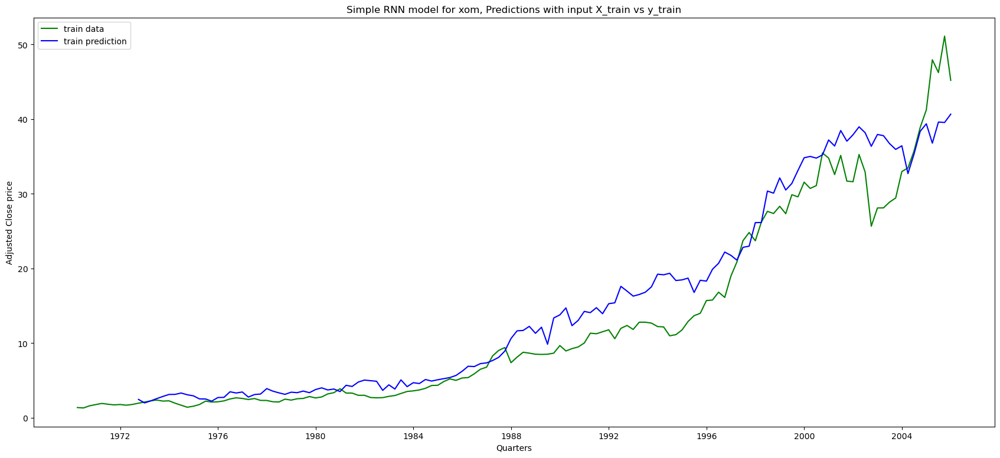

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


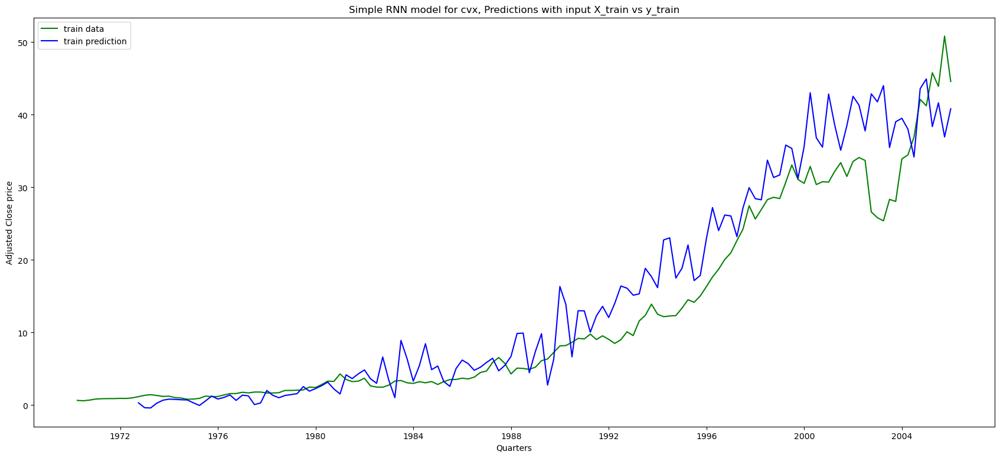

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


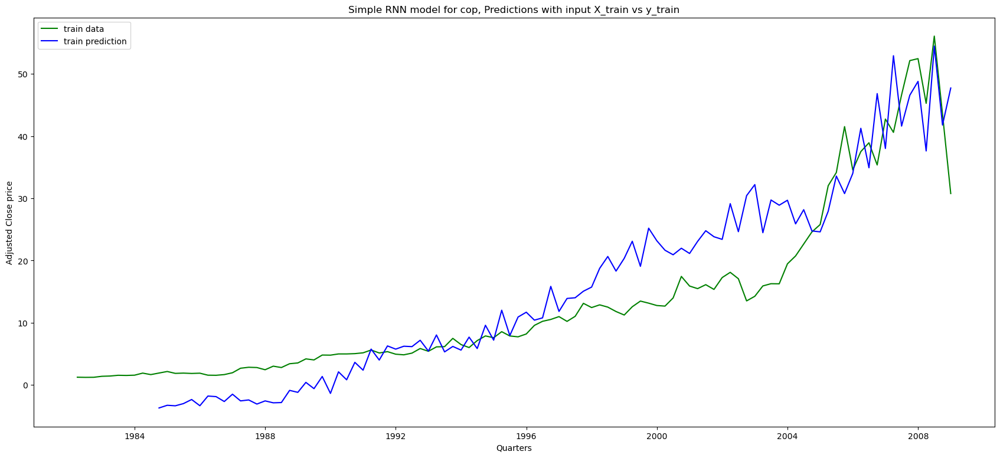

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


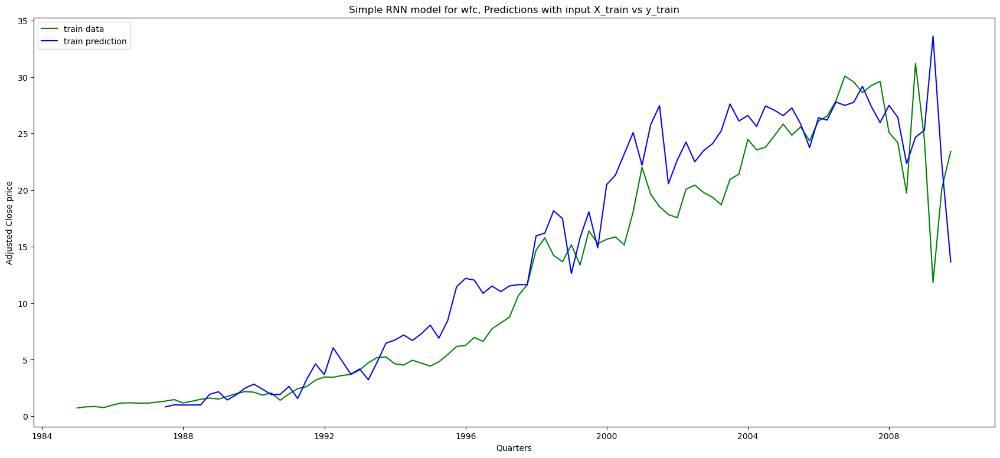

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


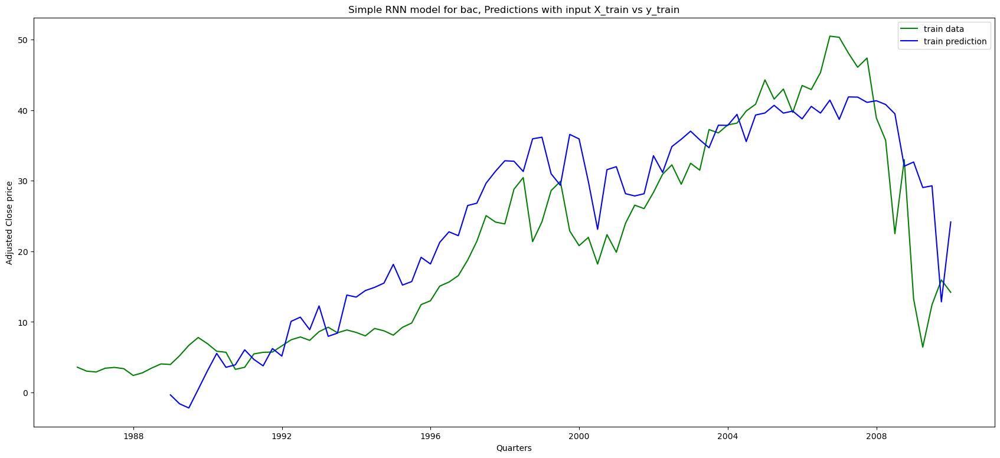

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


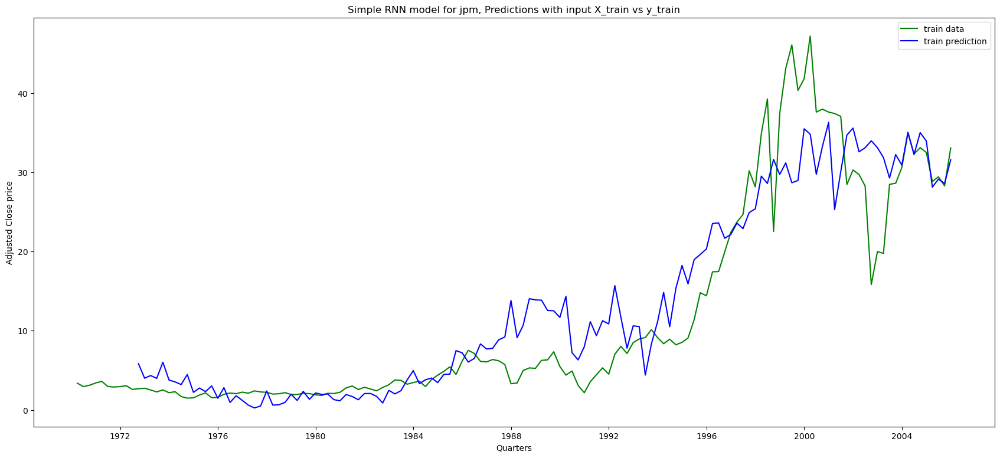

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


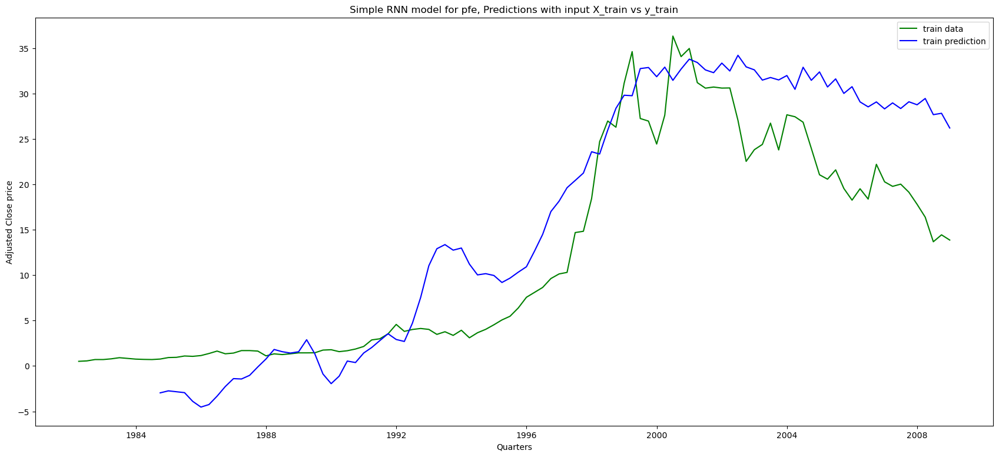

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


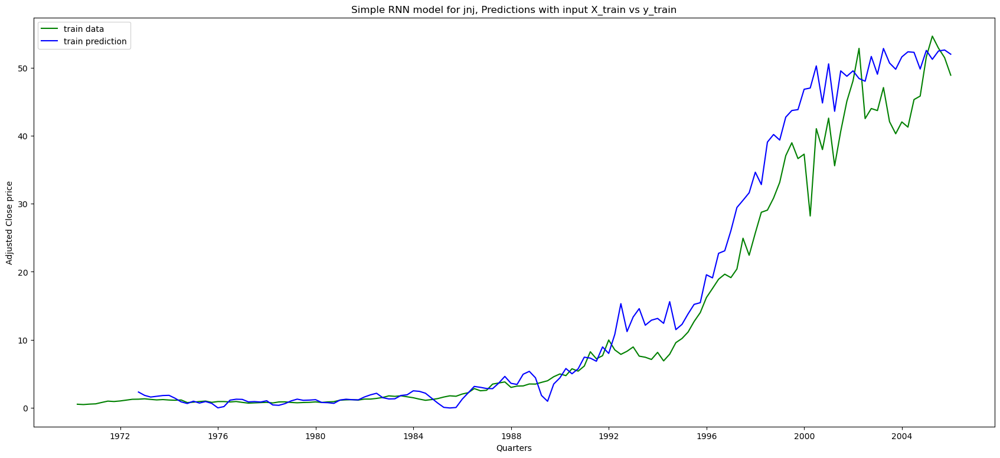

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


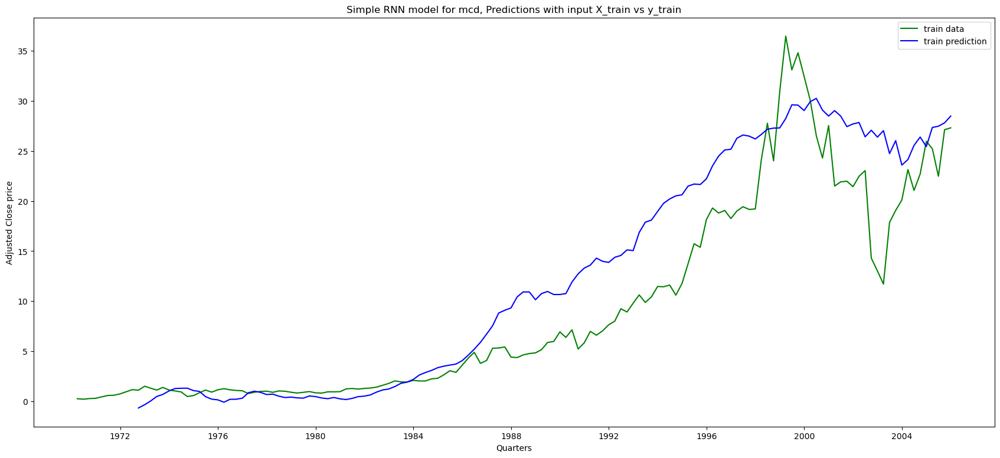

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


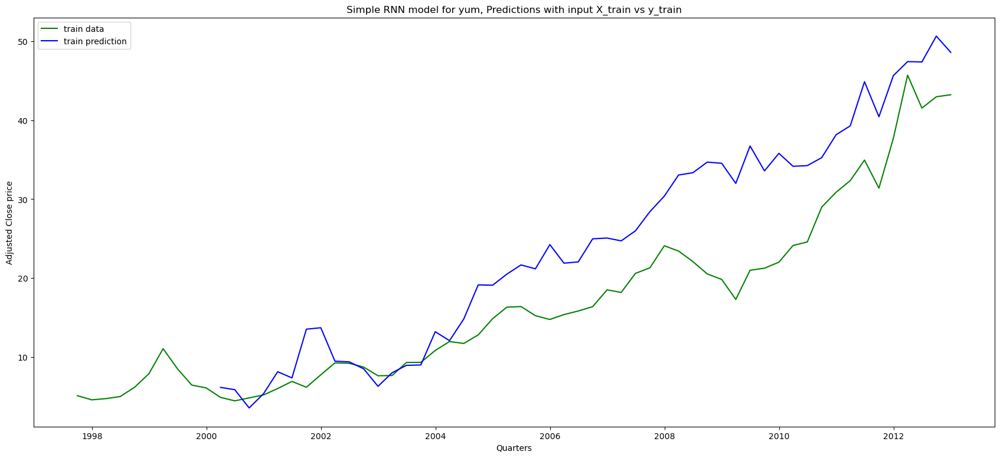

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


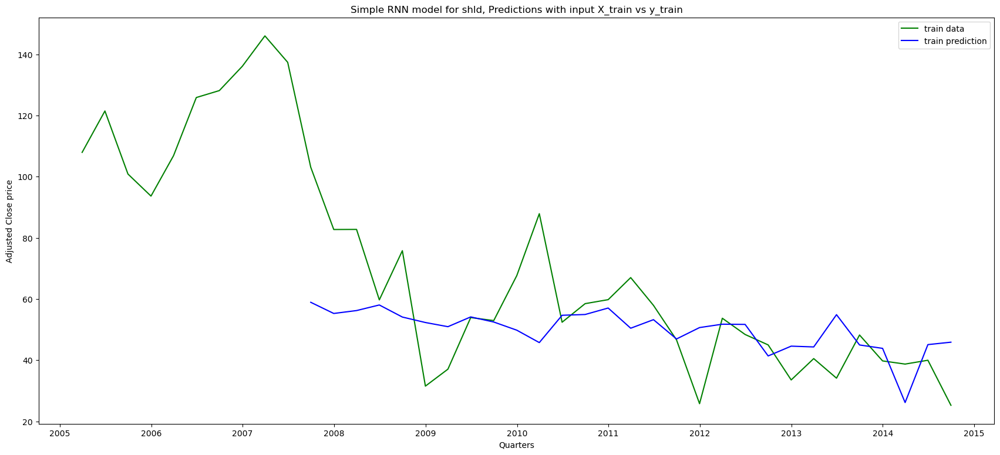

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


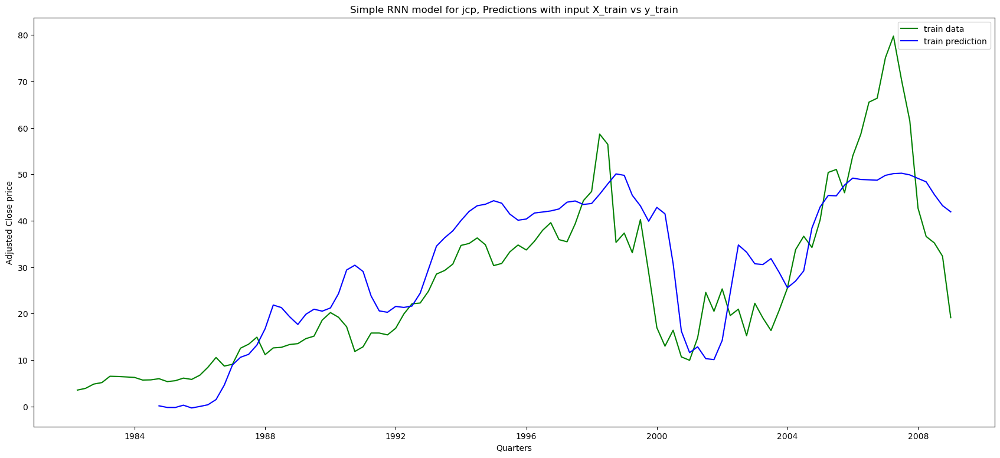

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


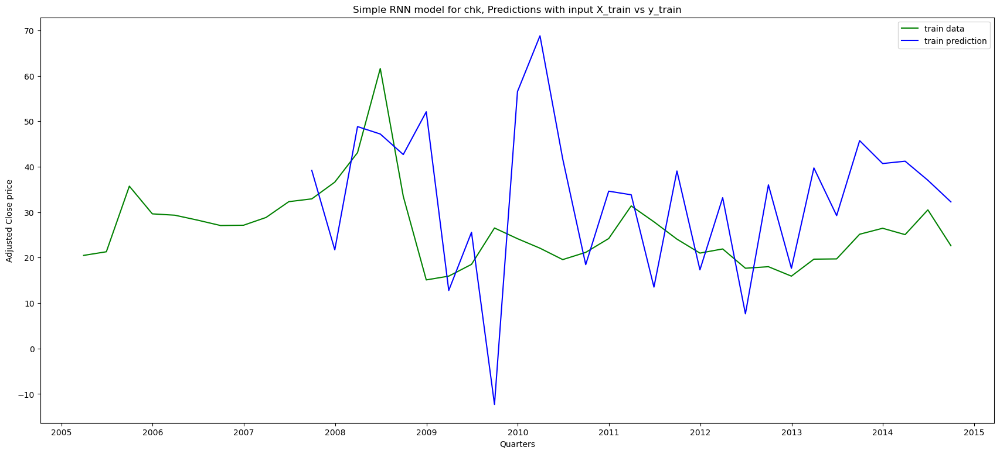

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


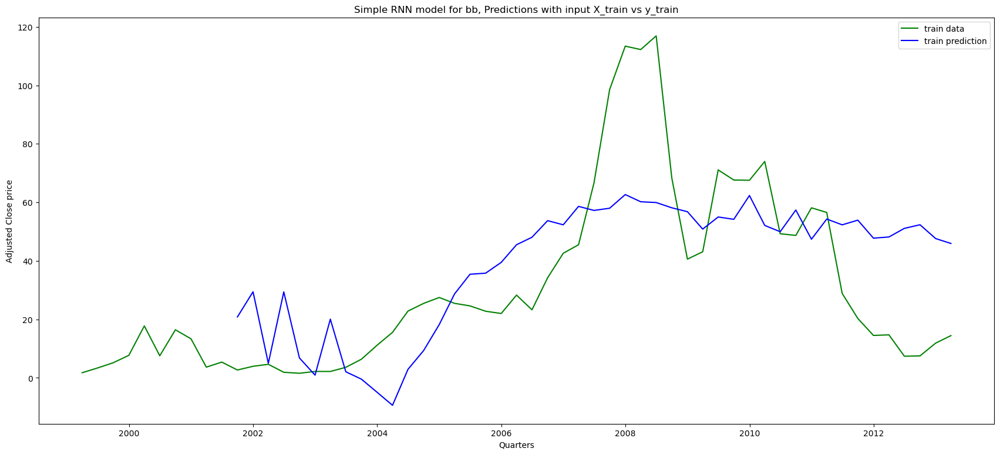

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


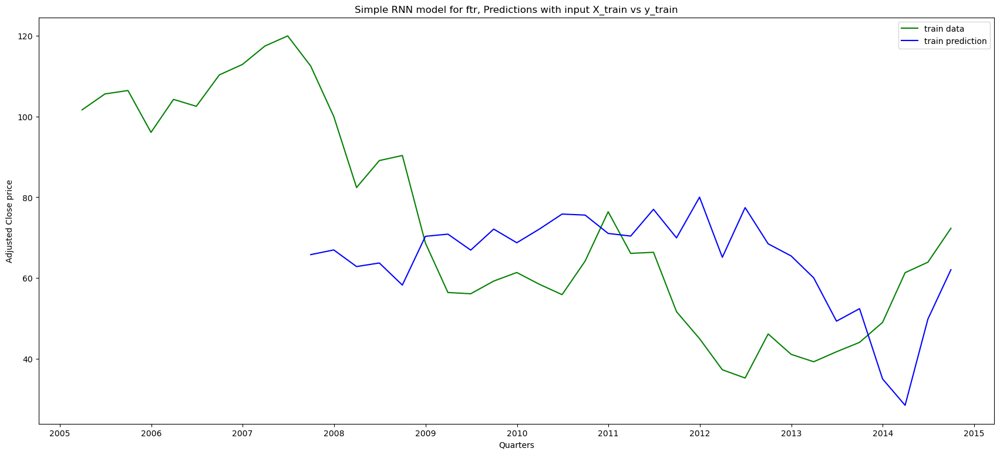

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


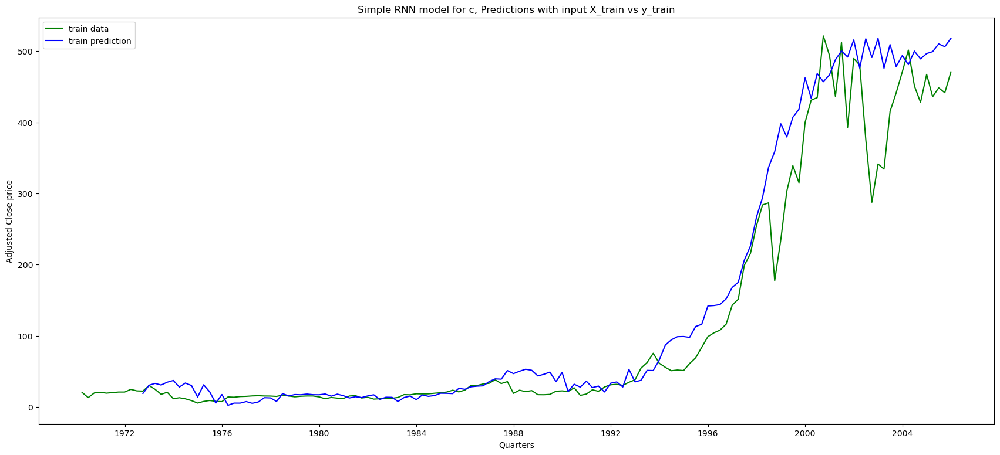

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


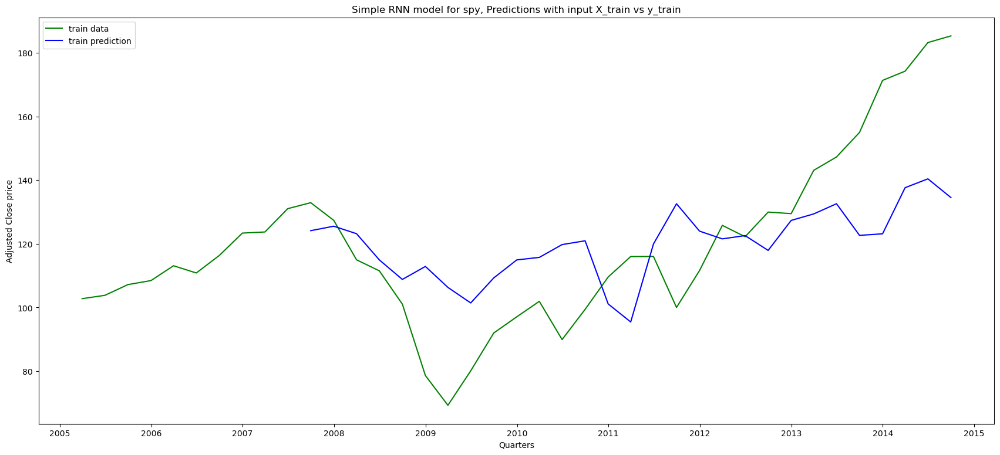

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


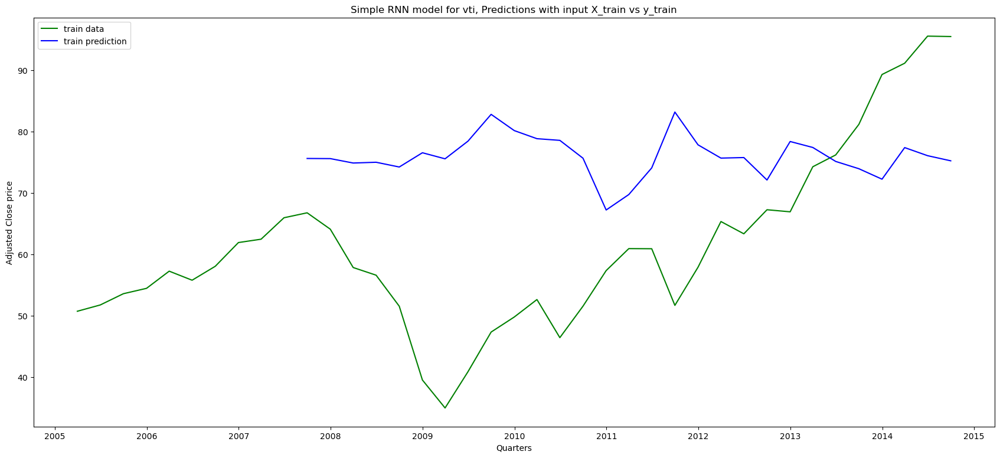

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


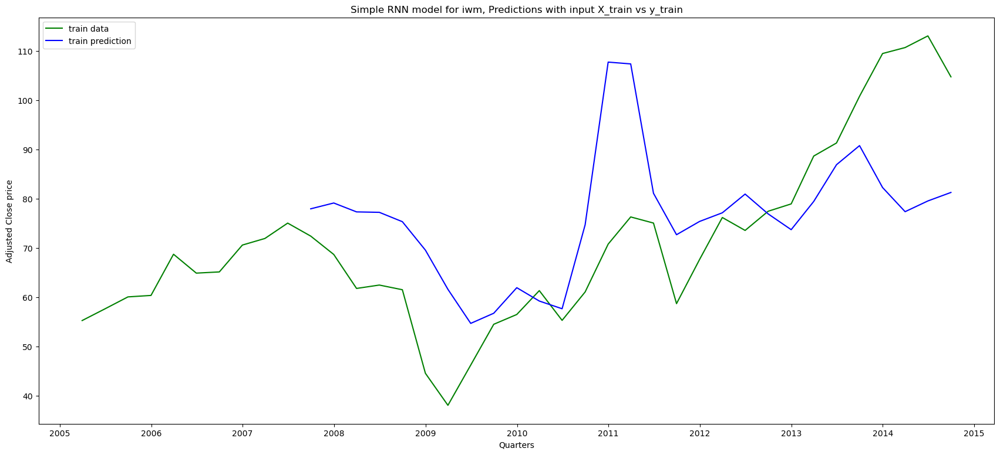

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


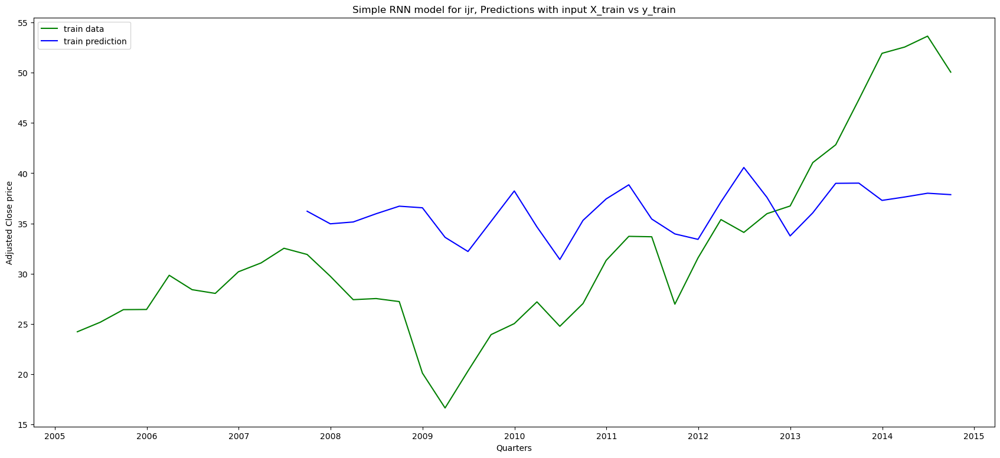

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


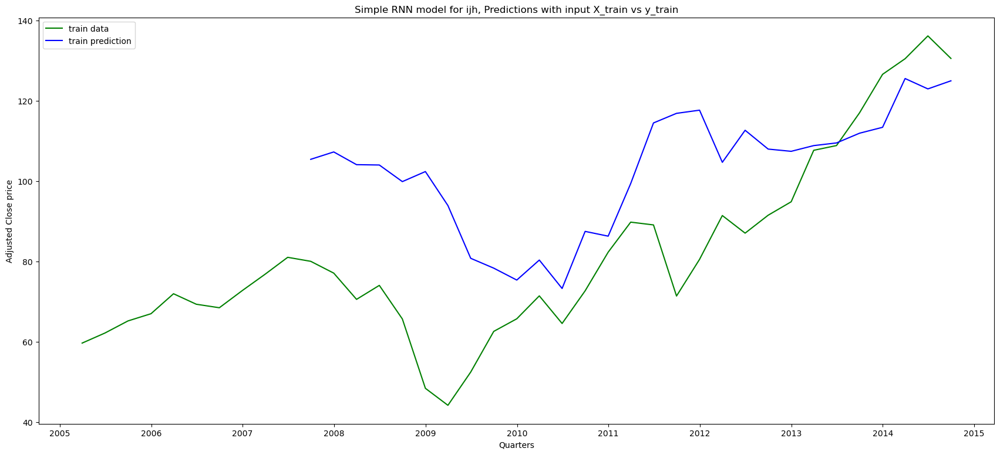

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


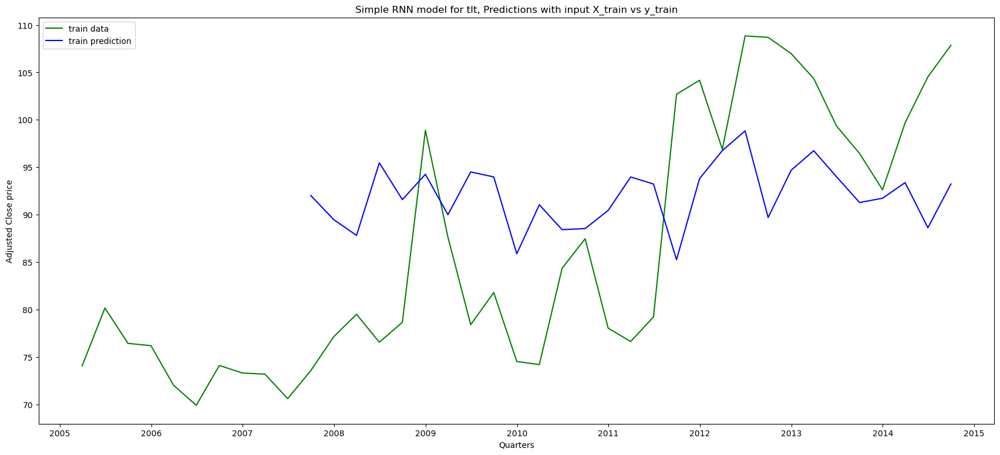

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


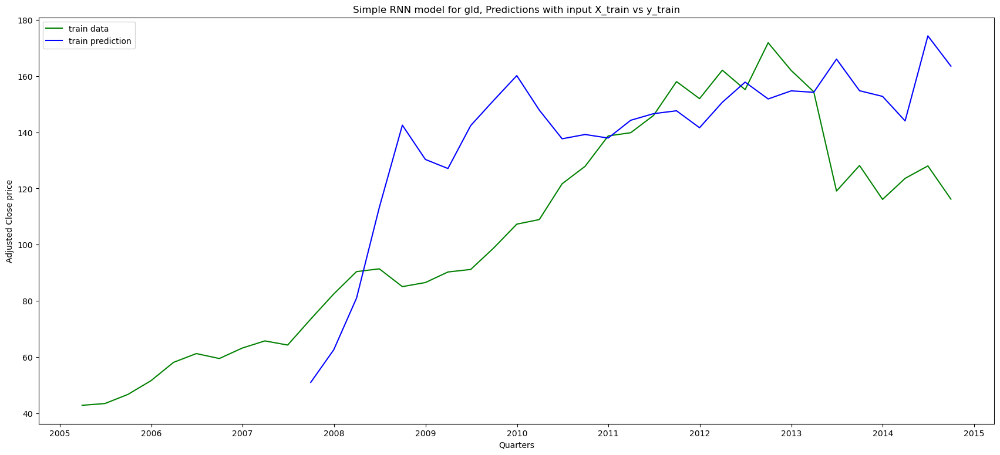

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


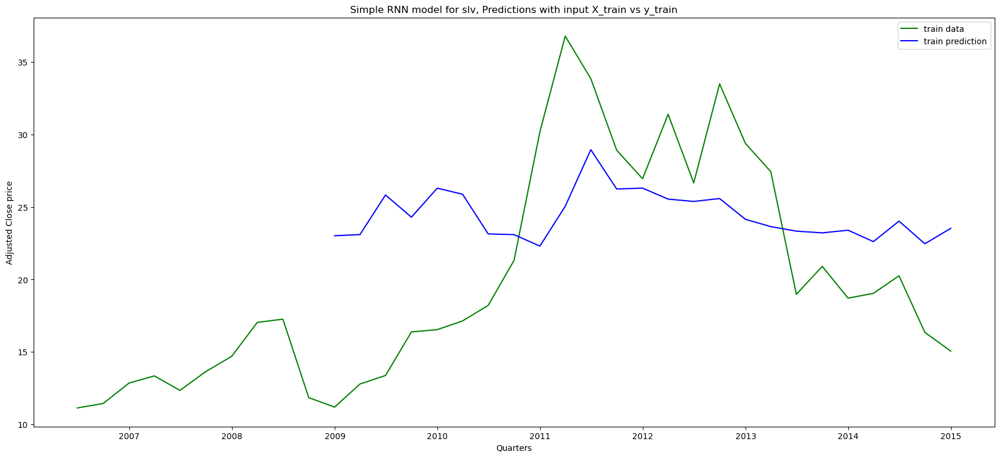

In [189]:
y_preds = {}

for t in tickers:
    y_preds[t] = models[t].predict(X_trains[t])  # predictions
    y_preds[t] = scales[t].inverse_transform(y_preds[t]) # scaling back from 0-1 to original
    
    # Visualizing predictions in train dataset
    plt.figure(figsize = (21,9))
    plt.plot(train_dfs[t]['Date'],train_dfs[t]['Close'], color = "g", label = "train data")
    plt.plot(train_dfs[t]['Date'].iloc[Lookback:],y_preds[t], color = "b", label = "train prediction" )
    plt.xlabel("Quarters")
    plt.ylabel("Adjusted Close price")
    plt.title(f"Simple RNN model for {t}, Predictions with input X_train vs y_train")
    plt.legend()
    plt.show()

Making test predictions.

In [150]:
y_test_preds = {}

for t in tickers:
    # predictions for test
    y_test_preds[t] = models[t].predict(X_tests[t])
    y_test_preds[t] = test_scales[t].inverse_transform(y_test_preds[t])


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 467ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
2/2 ━━━━

Making combined charts with train and test data and predictions.

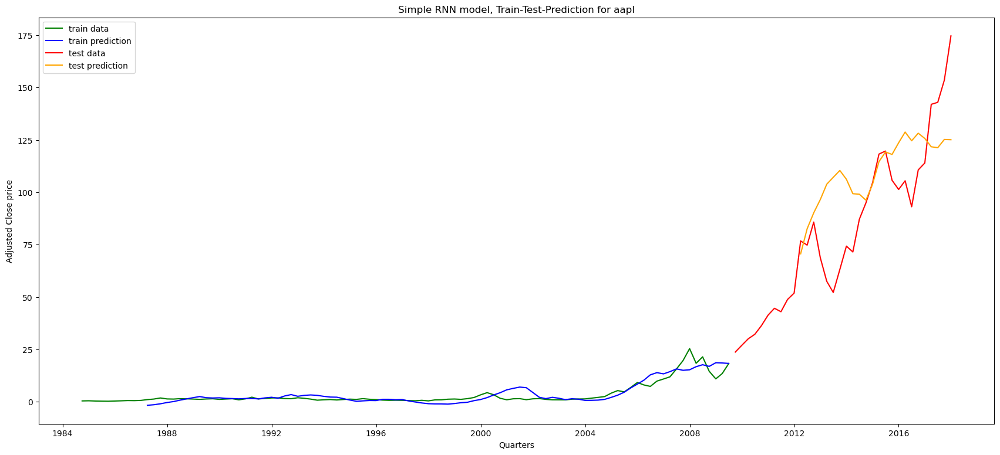

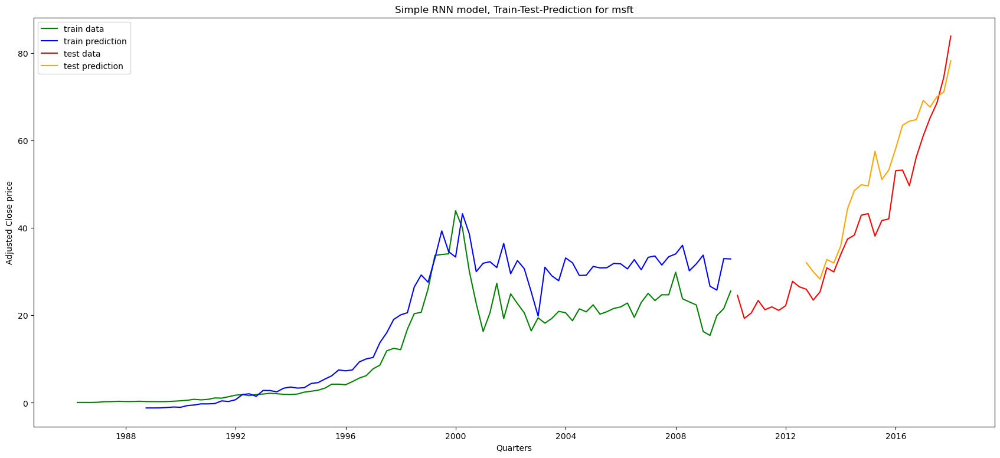

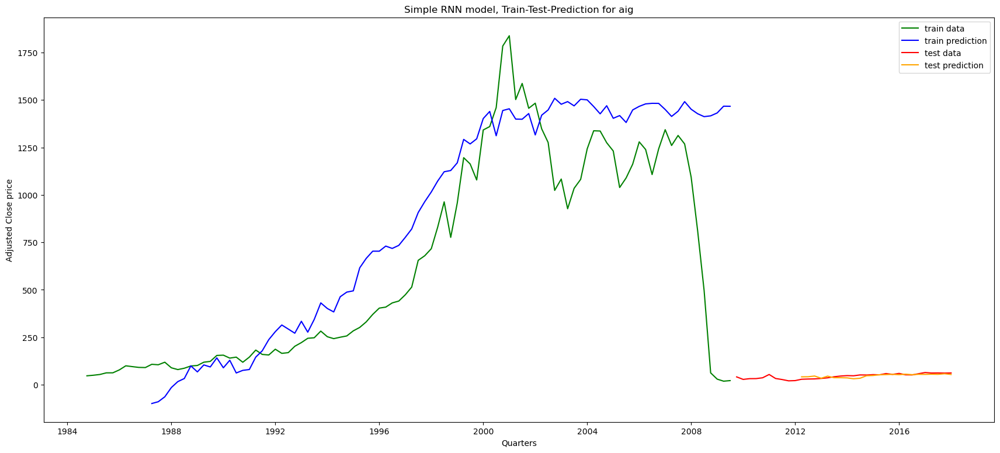

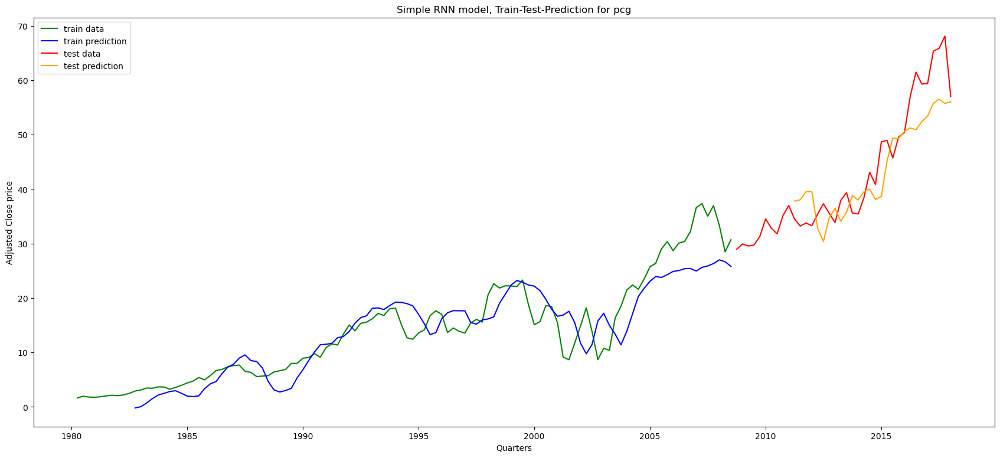

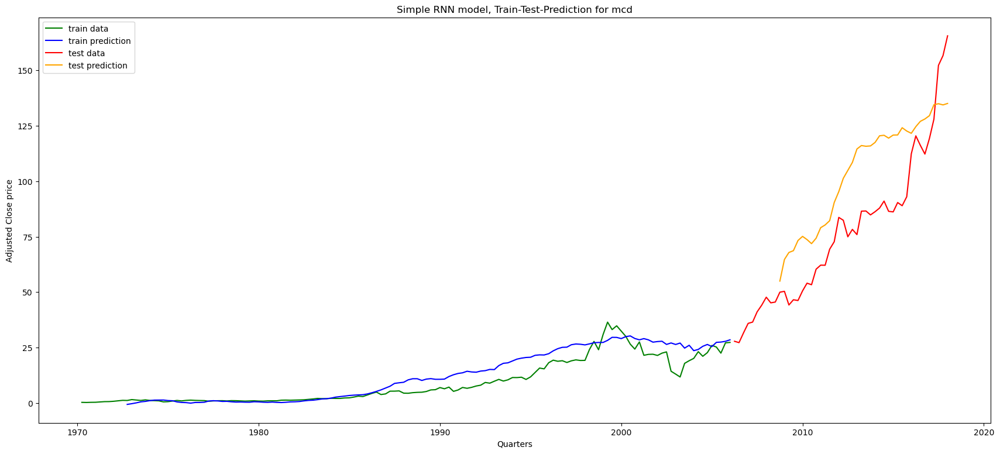

...

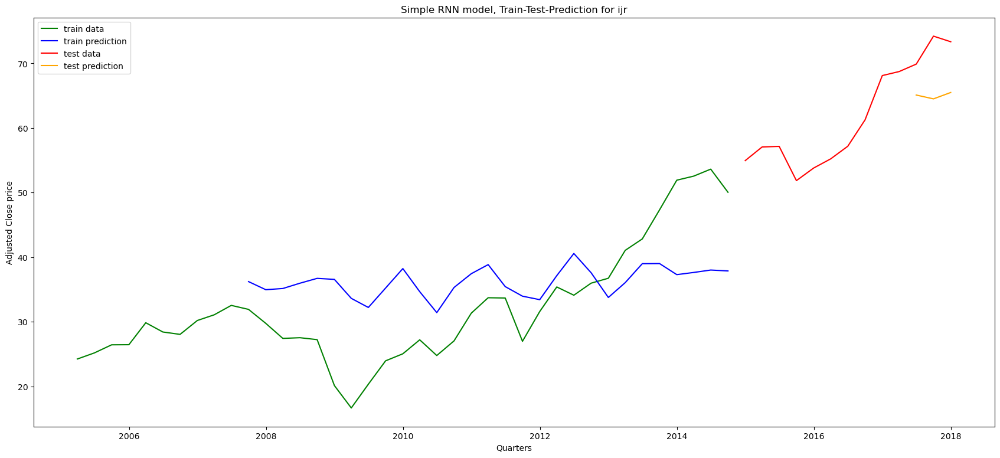

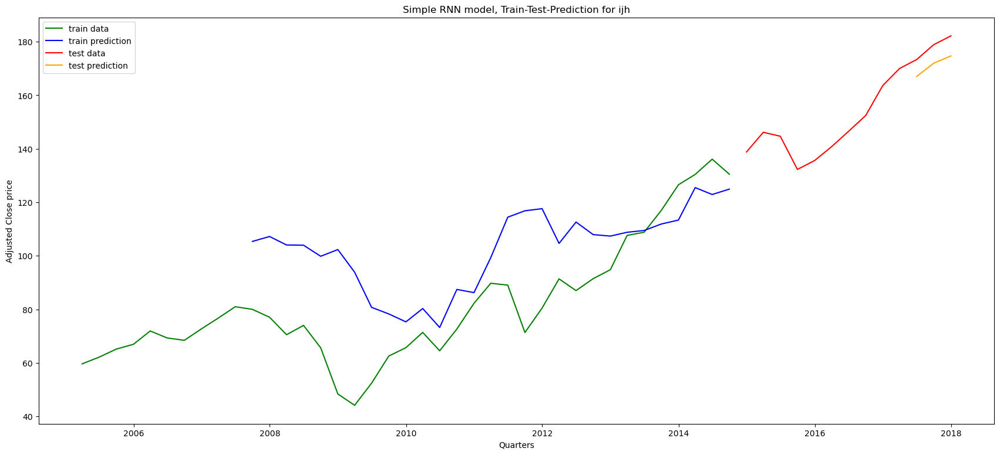

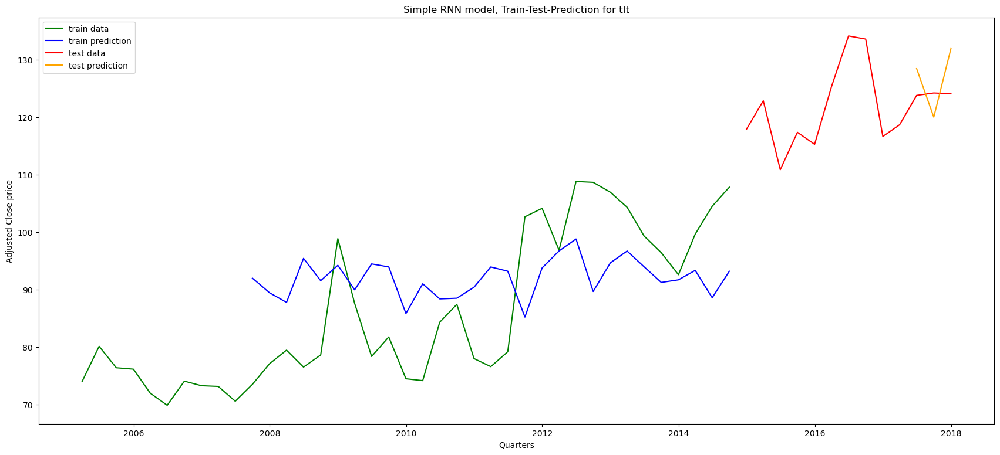

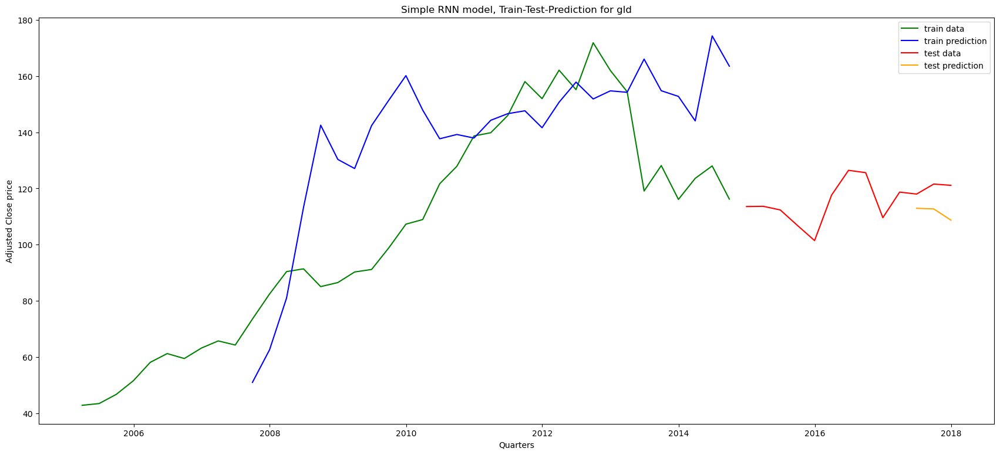

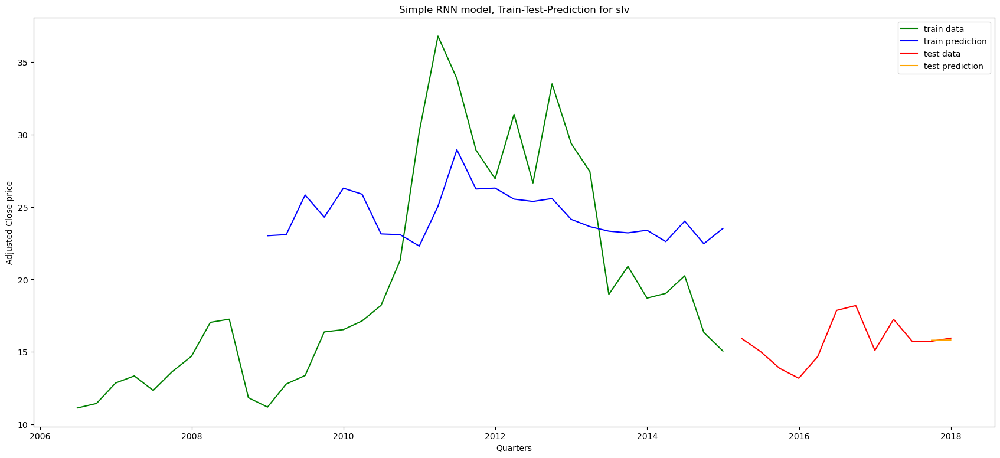

In [203]:
# Combined chart with train and test with predictions
for t in tickers:
    plt.subplots(figsize =(21,9))
    plt.plot(train_dfs[t]['Date'],train_dfs[t]['Close'], color = "g", label = "train data")
    plt.plot(train_dfs[t]['Date'].iloc[Lookback:],y_preds[t], color = "b", label = "train prediction" )
    plt.plot(test_dfs[t]['Date'], test_dfs[t]['Close'], label = "test data", color = "r")
    plt.plot(test_dfs[t]['Date'].iloc[Lookback:], y_test_preds[t], label = "test prediction", color = "orange")
    plt.xlabel("Quarters")
    plt.ylabel("Adjusted Close price")
    plt.title(f"Simple RNN model, Train-Test-Prediction for {t}")
    plt.legend()
    plt.show()

Calculating MSE for train and for test.

In [152]:
mse_train, mse_test = {},{}

for t in tickers:
    # Calculating MSE for train 
    y_trains_unscaled = scales[t].inverse_transform(y_trains[t])
    mse_train[t] = mean_squared_error(y_trains_unscaled, y_preds[t])
    print(f'Mean squared error for {t} train {mse_train[t]:.6}')

    # Calculating MSE for test
    y_test_unscaled = test_scales[t].inverse_transform(y_tests[t])
    mse_test[t] = mean_squared_error(y_test_unscaled, y_test_preds[t])
    print(f'Mean squared error for {t} test {mse_test[t]:.6}')

Mean squared error for aapl train 5.95889
Mean squared error for aapl test 708.87
Mean squared error for msft train 51.837
Mean squared error for msft test 66.6739
Mean squared error for aig train 1.50439e+05
Mean squared error for aig test 75.3406
Mean squared error for pcg train 17.0708
Mean squared error for pcg test 32.8735
Mean squared error for mcd train 22.2622
Mean squared error for mcd test 571.698
Mean squared error for bcs train 41.3233
Mean squared error for bcs test 1.01912
Mean squared error for nvda train 53.1723
Mean squared error for nvda test 3402.5
Mean squared error for intc train 29.0733
Mean squared error for intc test 39.5671
Mean squared error for amzn train 2080.75
Mean squared error for amzn test 93920.0
Mean squared error for duk train 42.0549
Mean squared error for duk test 56.277
Mean squared error for so train 19.5492
Mean squared error for so test 39.0339
Mean squared error for exc train 38.1249
Mean squared error for exc test 17.8158
Mean squared error f

Calculating MSE with actual vs. SMA. SMA serves as a baseline prediction. Should be compared with MSE for test.

In [197]:
sma_window = 8
sma = {}
mse_sma = {}

for t in tickers:
    # Calculating SMA
    sma[t] = stock_dfs[t]['Close'].rolling(sma_window).mean()
    # Calculating MSE for SMA as a baseline
    mse_sma[t] = mean_squared_error(stock_dfs[t]['Close'].iloc[sma_window - 1:], sma[t].dropna())
    print(f'Mean squared error for {t} sma baseline {mse_sma[t]:.6}')

Mean squared error for aapl sma baseline 101.294
Mean squared error for msft sma baseline 30.2336
Mean squared error for aig sma baseline 36068.4
Mean squared error for pcg sma baseline 12.3498
Mean squared error for mcd sma baseline 42.1393
Mean squared error for bcs sma baseline 41.9718
Mean squared error for nvda sma baseline 493.926
Mean squared error for intc sma baseline 18.0998
Mean squared error for amzn sma baseline 7037.32
Mean squared error for duk sma baseline 30.1351
Mean squared error for so sma baseline 4.83893
Mean squared error for exc sma baseline 20.2475
Mean squared error for t sma baseline 7.68057
Mean squared error for vz sma baseline 12.8496
Mean squared error for ctl sma baseline 11.059
Mean squared error for o sma baseline 28.1185
Mean squared error for spg sma baseline 192.572
Mean squared error for nly sma baseline 0.847198
Mean squared error for pg sma baseline 15.4882
Mean squared error for ko sma baseline 5.44057
Mean squared error for pep sma baseline 21.

Charting everything and SMA in addition

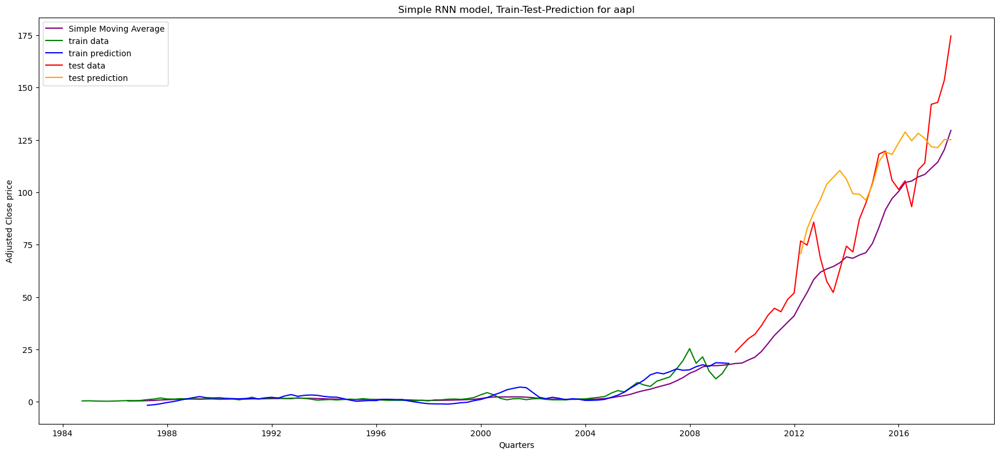

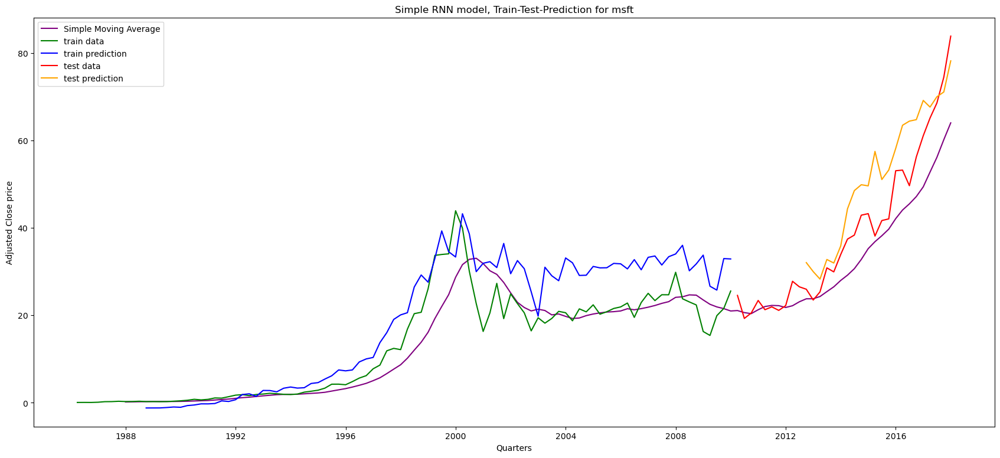

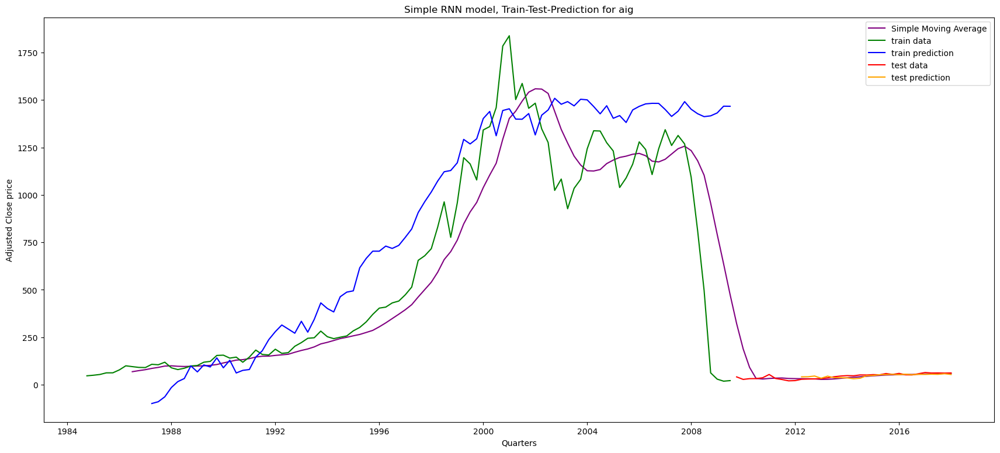

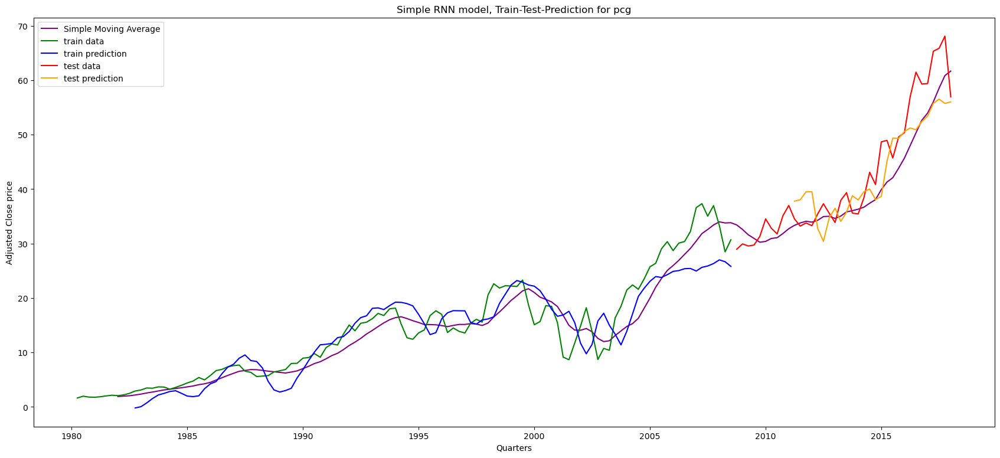

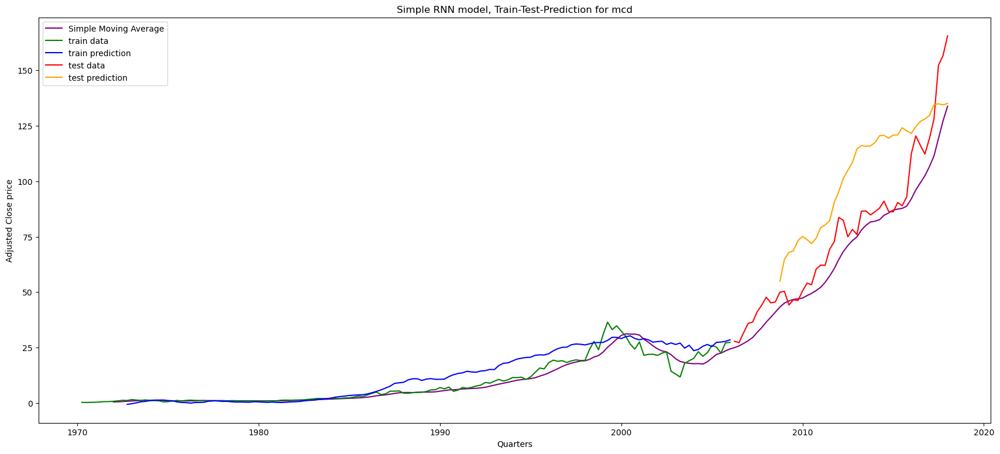

...

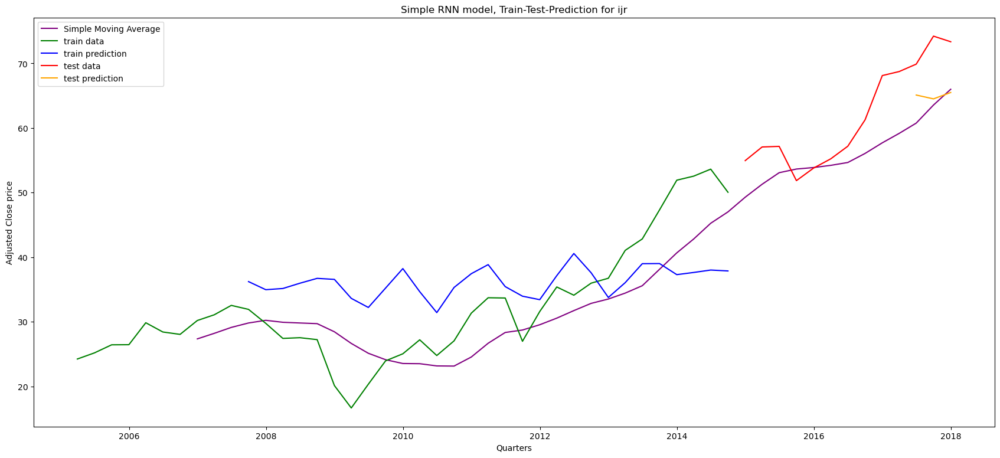

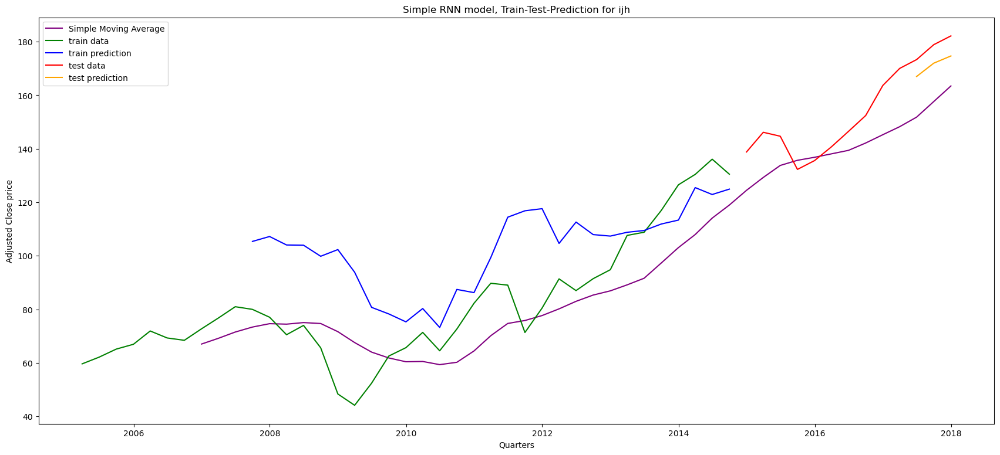

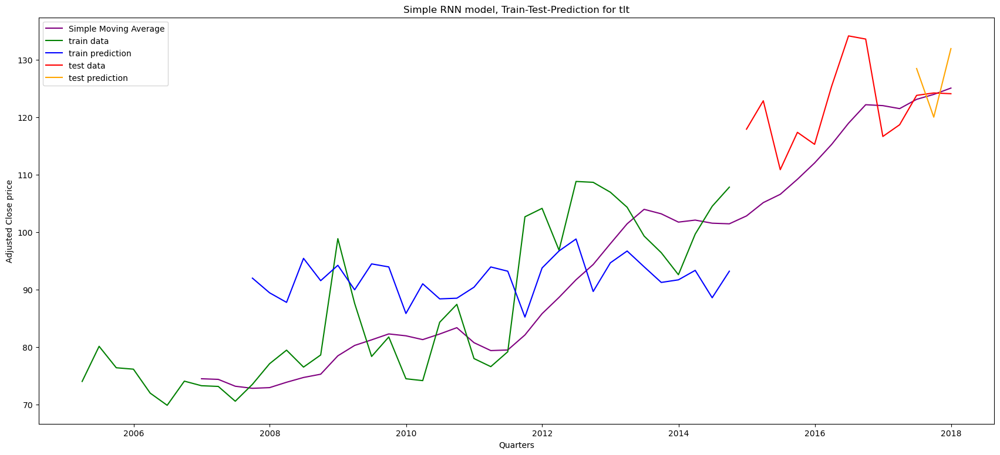

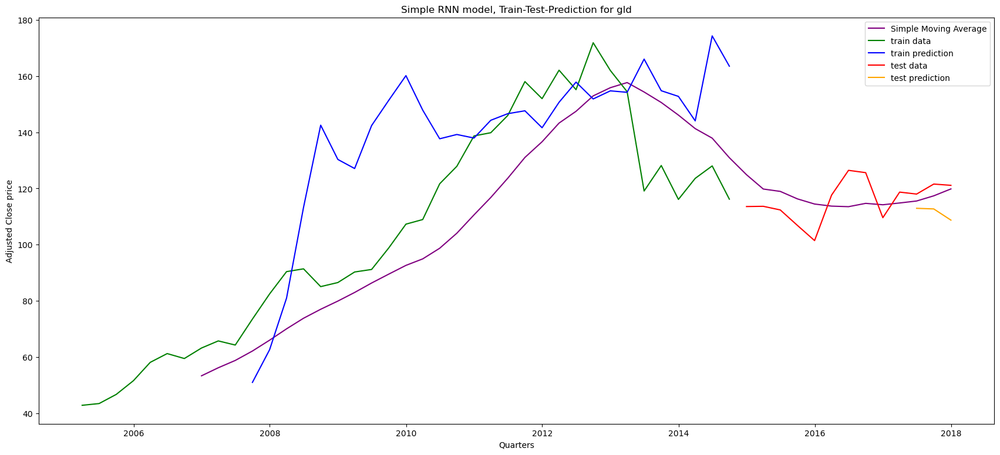

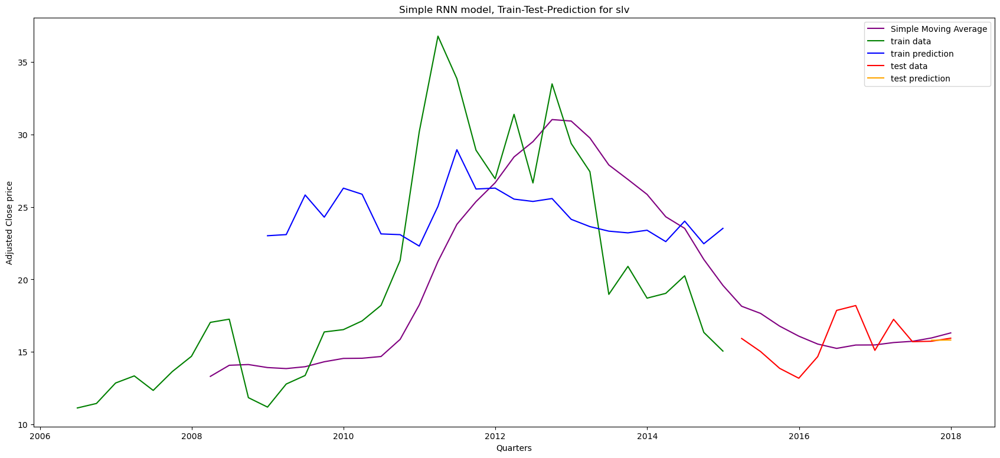

In [193]:
for t in tickers:
    plt.subplots(figsize =(21,9))
    # Adding SMA to plot
    plt.plot(stock_dfs[t]['Date'], sma[t], label = "Simple Moving Average", color = "purple")
    plt.plot(train_dfs[t]['Date'],train_dfs[t]['Close'], color = "g", label = "train data")
    plt.plot(train_dfs[t]['Date'].iloc[Lookback:],y_preds[t], color = "b", label = "train prediction" )
    plt.plot(test_dfs[t]['Date'], test_dfs[t]['Close'], label = "test data", color = "r")
    plt.plot(test_dfs[t]['Date'].iloc[Lookback:], y_test_preds[t], label = "test prediction", color = "orange")
    plt.xlabel("Quarters")
    plt.ylabel("Adjusted Close price")
    plt.title(f"Simple RNN model, Train-Test-Prediction for {t}")
    plt.legend()
    plt.show()

Alternative MSE calculation, where SMA serves as a basis, as if it is factual data, and test predictions serves as a prediction.

In [199]:
mse_sma_test = {}

for t in tickers:
    # Calculating MSE for SMA vs. test
    mse_sma_test[t] = mean_squared_error(sma[t].iloc[-y_test_preds[t].shape[0]:],y_test_preds[t] )
    print(f'Mean squared error for {t} sma vs. test {mse_sma_test[t]:.6}')

Mean squared error for aapl sma vs. test 761.993
Mean squared error for msft sma vs. test 205.3
Mean squared error for aig sma vs. test 42.0679
Mean squared error for pcg sma vs. test 12.4008
Mean squared error for mcd sma vs. test 836.954
Mean squared error for bcs sma vs. test 0.925702
Mean squared error for nvda sma vs. test 954.988
Mean squared error for intc sma vs. test 27.1869
Mean squared error for amzn sma vs. test 15610.1
Mean squared error for duk sma vs. test 113.459
Mean squared error for so sma vs. test 30.7074
Mean squared error for exc sma vs. test 8.44061
Mean squared error for t sma vs. test 19.4882
Mean squared error for vz sma vs. test 7.54851
Mean squared error for ctl sma vs. test 8.35105
Mean squared error for o sma vs. test 20.906
Mean squared error for spg sma vs. test 73.738
Mean squared error for nly sma vs. test 3.47972
Mean squared error for pg sma vs. test 162.812
Mean squared error for ko sma vs. test 14.5493
Mean squared error for pep sma vs. test 85.828